<a href="https://colab.research.google.com/github/cristina-iacob99/licenta/blob/main/Interferenta.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Setup

In [1]:
%tensorflow_version 2.x
import tensorflow as tf
device_name = tf.test.gpu_device_name()
if device_name != '/device:GPU:0':
  raise SystemError('GPU device not found')
print('Found GPU at: {}'.format(device_name))

Found GPU at: /device:GPU:0


'ghp_z(HayhkIaeF11Invg1KGWKjWYvfi150358zH'

ghp_z(HayhkIaeF11Invg1KGWKjWYvfi150358zH

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
# set the matplotlib backend so figures can be saved in the background
import matplotlib
matplotlib.use("Agg")

# import the necessary packages
from keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam
from keras.models import load_model
import keras.backend as K
import argparse
import os
import tensorflow
from tensorflow.keras import layers, models
from tensorflow.keras.applications.vgg16 import VGG16

output = '/content/drive/MyDrive/GitHub/licenta/outputs/output22'
checkpoint = '/content/drive/MyDrive/GitHub/licenta/outputs/output22/checkpoint1'
model = None
start_epoch = 0

train_datagen = ImageDataGenerator( rotation_range = 10, rescale = 1 / 255.0, zoom_range = 0.1, horizontal_flip = True, fill_mode = "nearest")
val_datagen = ImageDataGenerator(rescale = 1 / 255.0)
train_generator = train_datagen.flow_from_directory('/content/drive/MyDrive/GitHub/licenta/dataset_fer/train', target_size = (224, 224), batch_size = 128, class_mode = 'categorical')
val_generator = val_datagen.flow_from_directory( '/content/drive/MyDrive/GitHub/licenta/dataset_fer/val', target_size = (224, 224), batch_size = 128, class_mode = 'categorical')


# FOLOSIRE VGG16

## Loading VGG16 model

base_model = VGG16(weights="imagenet", include_top=False, input_shape=(224,224,3))
base_model.trainable = False ## Not trainable weights

## Add last layers

flatten_layer = layers.Flatten()
dense_layer_1 = layers.Dense(512, activation='relu')
dropout_layer = layers.Dropout(0.5)
prediction_layer = layers.Dense(6, activation='softmax')


model = models.Sequential([base_model, flatten_layer, dense_layer_1, dropout_layer, prediction_layer])

Found 4246 images belonging to 6 classes.
Found 529 images belonging to 6 classes.
58900480/58889256 [==============================] - 1s 0us/step


Se va schimba modelul EmotionVGG creat mai sus cu modelul VGG pentru a testa pe un model preantrenat.

In plus, se va face fine-tuning cu un strat de 512 de neuroni. Spre deosebire de 3.4, se va modifica learning rate-ul la 10^-4.

Rezultatele se salveaza in outputs/output22.



---

ANTRENARE

In [ ]:
print("[INFO] base model status... \n")
for i, layer in enumerate(base_model.layers):
  print(i, layer.name, layer.trainable)

print("\n\n[INFO] entire model status...\n")
for i, layer in enumerate(model.layers):
  print(i, layer.name, layer.trainable)

[INFO] base model status... 

0 input_2 False
1 block1_conv1 False
2 block1_conv2 False
3 block1_pool False
4 block2_conv1 False
5 block2_conv2 False
6 block2_pool False
7 block3_conv1 False
8 block3_conv2 False
9 block3_conv3 False
10 block3_pool False
11 block4_conv1 False
12 block4_conv2 False
13 block4_conv3 False
14 block4_pool False
15 block5_conv1 False
16 block5_conv2 False
17 block5_conv3 False
18 block5_pool False


[INFO] entire model status...

0 vgg16 False
1 flatten_1 True
2 dense_2 True
3 dropout_1 True
4 dense_3 True


In [ ]:
## Compile and fit model

print("[INFO] compiling model...")
opt = Adam(learning_rate = 1e-4)
model.compile(optimizer=opt, loss='categorical_crossentropy', metrics=['accuracy'])

# construct the set of callbacks
figPath = os.path.sep.join([output,"facial_emotion_recognition22_1.png"])
jsonPath = os.path.sep.join([output,"facial_emotion_recognitio22_1.json"])
model_checkpoint_callback = tensorflow.keras.callbacks.ModelCheckpoint(filepath=checkpoint, save_weights_only=False, monitor='val_accuracy', mode='max', save_best_only=True)
callbacks = [model_checkpoint_callback, TrainingMonitor(figPath, jsonPath=jsonPath, startAt=start_epoch)]

model.fit(train_generator, steps_per_epoch = 4246 // 128, epochs = 50, validation_data = val_generator, validation_steps = 529 // 128, max_queue_size = 128 * 2, callbacks = callbacks, verbose = 1)

[INFO] compiling model...
Epoch 1/50
22/33 [===================>..........] - ETA: 19s - loss: 1.5860 - accuracy: 0.3963

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 68s 2s/step - loss: 1.4627 - accuracy: 0.4371 - val_loss: 1.0480 - val_accuracy: 0.5859
Epoch 2/50


/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 67s 2s/step - loss: 1.0394 - accuracy: 0.5996 - val_loss: 0.8818 - val_accuracy: 0.6699
Epoch 3/50
16/33 [=============>................] - ETA: 31s - loss: 0.8852 - accuracy: 0.6675

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 67s 2s/step - loss: 0.8799 - accuracy: 0.6714 - val_loss: 0.8150 - val_accuracy: 0.6797
Epoch 4/50
 7/33 [=====>........................] - ETA: 42s - loss: 0.8694 - accuracy: 0.6633

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 67s 2s/step - loss: 0.8069 - accuracy: 0.6960 - val_loss: 0.7262 - val_accuracy: 0.7324
Epoch 5/50
11/33 [=========>....................] - ETA: 41s - loss: 0.7320 - accuracy: 0.7294

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 67s 2s/step - loss: 0.7333 - accuracy: 0.7195 - val_loss: 0.6770 - val_accuracy: 0.7637
Epoch 6/50
19/33 [================>.............] - ETA: 25s - loss: 0.6924 - accuracy: 0.7468

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.6949 - accuracy: 0.7460 - val_loss: 0.6687 - val_accuracy: 0.7461
Epoch 7/50
19/33 [================>.............] - ETA: 24s - loss: 0.6254 - accuracy: 0.7812

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.6413 - accuracy: 0.7715 - val_loss: 0.6559 - val_accuracy: 0.7480
Epoch 8/50
12/33 [=========>....................] - ETA: 35s - loss: 0.6078 - accuracy: 0.7832

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 67s 2s/step - loss: 0.5942 - accuracy: 0.7878 - val_loss: 0.6142 - val_accuracy: 0.7656
Epoch 9/50
18/33 [===============>..............] - ETA: 27s - loss: 0.5674 - accuracy: 0.7944

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 67s 2s/step - loss: 0.5682 - accuracy: 0.7948 - val_loss: 0.6282 - val_accuracy: 0.7754
Epoch 10/50
24/33 [====================>.........] - ETA: 16s - loss: 0.5501 - accuracy: 0.8078

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 67s 2s/step - loss: 0.5414 - accuracy: 0.8057 - val_loss: 0.6181 - val_accuracy: 0.7793
Epoch 11/50
31/33 [===========================>..] - ETA: 3s - loss: 0.5002 - accuracy: 0.8208

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.4999 - accuracy: 0.8225 - val_loss: 0.6030 - val_accuracy: 0.7676
Epoch 12/50
 3/33 [=>............................] - ETA: 53s - loss: 0.5092 - accuracy: 0.8203

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.4697 - accuracy: 0.8371 - val_loss: 0.6151 - val_accuracy: 0.7539
Epoch 13/50
 7/33 [=====>........................] - ETA: 47s - loss: 0.4375 - accuracy: 0.8471

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 66s 2s/step - loss: 0.4468 - accuracy: 0.8494 - val_loss: 0.5730 - val_accuracy: 0.7852
Epoch 14/50
32/33 [============================>.] - ETA: 1s - loss: 0.4314 - accuracy: 0.8541

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 65s 2s/step - loss: 0.4336 - accuracy: 0.8533 - val_loss: 0.6044 - val_accuracy: 0.7656
Epoch 15/50
28/33 [========================>.....] - ETA: 9s - loss: 0.4192 - accuracy: 0.8496 

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 67s 2s/step - loss: 0.4183 - accuracy: 0.8504 - val_loss: 0.5639 - val_accuracy: 0.7949
Epoch 16/50
 5/33 [===>..........................] - ETA: 51s - loss: 0.3959 - accuracy: 0.8672

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.4172 - accuracy: 0.8582 - val_loss: 0.5624 - val_accuracy: 0.7910
Epoch 17/50


/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.3891 - accuracy: 0.8633 - val_loss: 0.5484 - val_accuracy: 0.7910
Epoch 18/50
19/33 [================>.............] - ETA: 25s - loss: 0.3622 - accuracy: 0.8795

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.3590 - accuracy: 0.8817 - val_loss: 0.5407 - val_accuracy: 0.7949
Epoch 19/50


/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.3506 - accuracy: 0.8854 - val_loss: 0.5616 - val_accuracy: 0.7949
Epoch 20/50
22/33 [===================>..........] - ETA: 20s - loss: 0.3479 - accuracy: 0.8775

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.3326 - accuracy: 0.8859 - val_loss: 0.5682 - val_accuracy: 0.7812
Epoch 21/50
25/33 [=====================>........] - ETA: 14s - loss: 0.3354 - accuracy: 0.8882

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 67s 2s/step - loss: 0.3359 - accuracy: 0.8878 - val_loss: 0.5416 - val_accuracy: 0.8105
Epoch 22/50
25/33 [=====================>........] - ETA: 14s - loss: 0.3023 - accuracy: 0.9101

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.3086 - accuracy: 0.9060 - val_loss: 0.5694 - val_accuracy: 0.7969
Epoch 23/50
17/33 [==============>...............] - ETA: 28s - loss: 0.3122 - accuracy: 0.9005

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 67s 2s/step - loss: 0.3121 - accuracy: 0.8980 - val_loss: 0.5315 - val_accuracy: 0.8242
Epoch 24/50
30/33 [==========================>...] - ETA: 5s - loss: 0.2937 - accuracy: 0.9087

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 65s 2s/step - loss: 0.2956 - accuracy: 0.9082 - val_loss: 0.5236 - val_accuracy: 0.8223
Epoch 25/50
 6/33 [====>.........................] - ETA: 50s - loss: 0.2836 - accuracy: 0.9180

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 67s 2s/step - loss: 0.2797 - accuracy: 0.9128 - val_loss: 0.5237 - val_accuracy: 0.8262
Epoch 26/50
15/33 [============>.................] - ETA: 32s - loss: 0.2755 - accuracy: 0.9085

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.2817 - accuracy: 0.9070 - val_loss: 0.5384 - val_accuracy: 0.8086
Epoch 27/50
32/33 [============================>.] - ETA: 1s - loss: 0.2628 - accuracy: 0.9145

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.2630 - accuracy: 0.9145 - val_loss: 0.5298 - val_accuracy: 0.8203
Epoch 28/50
11/33 [=========>....................] - ETA: 41s - loss: 0.2611 - accuracy: 0.9162

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.2505 - accuracy: 0.9208 - val_loss: 0.5144 - val_accuracy: 0.8223
Epoch 29/50
29/33 [=========================>....] - ETA: 7s - loss: 0.2500 - accuracy: 0.9190

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.2527 - accuracy: 0.9172 - val_loss: 0.5203 - val_accuracy: 0.8105
Epoch 30/50
18/33 [===============>..............] - ETA: 26s - loss: 0.2443 - accuracy: 0.9236

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.2423 - accuracy: 0.9240 - val_loss: 0.5374 - val_accuracy: 0.8184
Epoch 31/50
16/33 [=============>................] - ETA: 31s - loss: 0.2356 - accuracy: 0.9274

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.2441 - accuracy: 0.9252 - val_loss: 0.5241 - val_accuracy: 0.8105
Epoch 32/50
13/33 [==========>...................] - ETA: 35s - loss: 0.2231 - accuracy: 0.9365

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 67s 2s/step - loss: 0.2284 - accuracy: 0.9342 - val_loss: 0.5309 - val_accuracy: 0.8320
Epoch 33/50
14/33 [===========>..................] - ETA: 35s - loss: 0.2145 - accuracy: 0.9353

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 65s 2s/step - loss: 0.2181 - accuracy: 0.9342 - val_loss: 0.5363 - val_accuracy: 0.8301
Epoch 34/50


/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 68s 2s/step - loss: 0.2134 - accuracy: 0.9381 - val_loss: 0.5287 - val_accuracy: 0.8379
Epoch 35/50
18/33 [===============>..............] - ETA: 27s - loss: 0.2076 - accuracy: 0.9345

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.2096 - accuracy: 0.9354 - val_loss: 0.5442 - val_accuracy: 0.8379
Epoch 36/50
33/33 [==============================] - ETA: 0s - loss: 0.2028 - accuracy: 0.9400

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.2028 - accuracy: 0.9400 - val_loss: 0.5231 - val_accuracy: 0.8086
Epoch 37/50
14/33 [===========>..................] - ETA: 32s - loss: 0.1901 - accuracy: 0.9448

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.2033 - accuracy: 0.9354 - val_loss: 0.5414 - val_accuracy: 0.8105
Epoch 38/50
26/33 [======================>.......] - ETA: 12s - loss: 0.1846 - accuracy: 0.9479

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.1858 - accuracy: 0.9454 - val_loss: 0.5481 - val_accuracy: 0.8223
Epoch 39/50
23/33 [===================>..........] - ETA: 17s - loss: 0.1773 - accuracy: 0.9503

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.1740 - accuracy: 0.9492 - val_loss: 0.5344 - val_accuracy: 0.8242
Epoch 40/50
32/33 [============================>.] - ETA: 1s - loss: 0.1783 - accuracy: 0.9471

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.1774 - accuracy: 0.9471 - val_loss: 0.5509 - val_accuracy: 0.8359
Epoch 41/50
28/33 [========================>.....] - ETA: 9s - loss: 0.1686 - accuracy: 0.9528 

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 67s 2s/step - loss: 0.1743 - accuracy: 0.9505 - val_loss: 0.5330 - val_accuracy: 0.8398
Epoch 42/50
 3/33 [=>............................] - ETA: 56s - loss: 0.1594 - accuracy: 0.9583

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.1709 - accuracy: 0.9519 - val_loss: 0.5391 - val_accuracy: 0.8320
Epoch 43/50
21/33 [==================>...........] - ETA: 21s - loss: 0.1652 - accuracy: 0.9535

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.1702 - accuracy: 0.9507 - val_loss: 0.5137 - val_accuracy: 0.8301
Epoch 44/50
10/33 [========>.....................] - ETA: 39s - loss: 0.1619 - accuracy: 0.9549

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.1577 - accuracy: 0.9570 - val_loss: 0.5394 - val_accuracy: 0.8242
Epoch 45/50
33/33 [==============================] - ETA: 0s - loss: 0.1525 - accuracy: 0.9597

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.1525 - accuracy: 0.9597 - val_loss: 0.5472 - val_accuracy: 0.8203
Epoch 46/50
11/33 [=========>....................] - ETA: 41s - loss: 0.1429 - accuracy: 0.9602

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.1512 - accuracy: 0.9590 - val_loss: 0.5663 - val_accuracy: 0.8145
Epoch 47/50
17/33 [==============>...............] - ETA: 28s - loss: 0.1614 - accuracy: 0.9585

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.1499 - accuracy: 0.9619 - val_loss: 0.5664 - val_accuracy: 0.8223
Epoch 48/50
33/33 [==============================] - ETA: 0s - loss: 0.1440 - accuracy: 0.9553

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.1440 - accuracy: 0.9553 - val_loss: 0.5312 - val_accuracy: 0.8379
Epoch 49/50
28/33 [========================>.....] - ETA: 9s - loss: 0.1401 - accuracy: 0.9584 

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 63s 2s/step - loss: 0.1429 - accuracy: 0.9570 - val_loss: 0.5635 - val_accuracy: 0.8223
Epoch 50/50
22/33 [===================>..........] - ETA: 20s - loss: 0.1553 - accuracy: 0.9521

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 66s 2s/step - loss: 0.1520 - accuracy: 0.9536 - val_loss: 0.5725 - val_accuracy: 0.8105




---

TESTARE

In [ ]:
# import the necessary packages
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import load_model
import argparse
from sklearn.metrics import classification_report
from sklearn.preprocessing import LabelBinarizer
import numpy as np

model = '/content/drive/MyDrive/GitHub/licenta/outputs/output22/checkpoint1'

test_datagen = ImageDataGenerator(rescale = 1 / 255.0)
test_generator = test_datagen.flow_from_directory( '/content/drive/MyDrive/GitHub/licenta/dataset_fer/test', target_size = (224, 224), batch_size = 128, class_mode = "categorical")

# load the model from disk
print("[INFO] loading {}...".format(model))
model = load_model(model)


# evaluate the network
(loss, acc) = model.evaluate(test_generator, steps = 540 // 128, max_queue_size = 128 * 2)

# get the ground truth of your data. 
test_labels  =test_generator.classes 

# predict the probability distribution of the data
predictions = model.predict(test_generator)

# get the class with highest probability for each sample
y_pred = np.argmax(predictions, axis=-1)

# get the classification report
print(classification_report(test_labels, y_pred))

print("\n\n[INFO] accuracy: {:.2f}".format(acc * 100))

Found 540 images belonging to 6 classes.
[INFO] loading /content/drive/MyDrive/GitHub/licenta/outputs/output22/checkpoint1...
4/4 [==============================] - 3s 680ms/step - loss: 0.4847 - accuracy: 0.8379
              precision    recall  f1-score   support

           0       0.15      0.16      0.16        96
           1       0.13      0.11      0.12        81
           2       0.20      0.20      0.20        99
           3       0.15      0.14      0.15        94
           4       0.15      0.17      0.16        88
           5       0.14      0.15      0.14        82

    accuracy                           0.16       540
   macro avg       0.15      0.15      0.15       540
weighted avg       0.16      0.16      0.16       540



[INFO] accuracy: 83.79




---



---

ANTRENARE

In [ ]:
output = '/content/drive/MyDrive/GitHub/licenta/outputs/output22'
checkpoint = '/content/drive/MyDrive/GitHub/licenta/outputs/output22/checkpoint2'
start_epoch = 0

for layer in base_model.layers[11:]:
  layer.trainable = True

print("[INFO] base model status... \n")
for i, layer in enumerate(base_model.layers):
  print(i, layer.name, layer.trainable)

print("\n\n[INFO] entire model status...\n\n")
for i, layer in enumerate(model.layers):
  print(i, layer.name, layer.trainable)

[INFO] base model status... 

0 input_2 False
1 block1_conv1 False
2 block1_conv2 False
3 block1_pool False
4 block2_conv1 False
5 block2_conv2 False
6 block2_pool False
7 block3_conv1 False
8 block3_conv2 False
9 block3_conv3 False
10 block3_pool False
11 block4_conv1 True
12 block4_conv2 True
13 block4_conv3 True
14 block4_pool True
15 block5_conv1 True
16 block5_conv2 True
17 block5_conv3 True
18 block5_pool True


[INFO] entire model status...


0 vgg16 False
1 flatten_1 True
2 dense_2 True
3 dropout_1 True
4 dense_3 True


In [ ]:
## Compile and fit model

print("[INFO] compiling model...")
opt = Adam(learning_rate = 1e-4)
model.compile(optimizer=opt, loss='categorical_crossentropy', metrics=['accuracy'])

# construct the set of callbacks
figPath = os.path.sep.join([output,"facial_emotion_recognition22_2.png"])
jsonPath = os.path.sep.join([output,"facial_emotion_recognition22_2.json"])
model_checkpoint_callback = tensorflow.keras.callbacks.ModelCheckpoint(filepath=checkpoint, save_weights_only=False, monitor='val_accuracy', mode='max', save_best_only=True)
callbacks = [model_checkpoint_callback, TrainingMonitor(figPath, jsonPath=jsonPath, startAt=start_epoch)]

model.fit(train_generator, steps_per_epoch = 4246 // 128, epochs = 50, validation_data = val_generator, validation_steps = 529 // 128, max_queue_size = 128 * 2, callbacks = callbacks, verbose = 1)

[INFO] compiling model...
Epoch 1/50
13/33 [==========>...................] - ETA: 34s - loss: 0.2224 - accuracy: 0.9313

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 68s 2s/step - loss: 0.2068 - accuracy: 0.9347 - val_loss: 0.5422 - val_accuracy: 0.8125
Epoch 2/50
26/33 [======================>.......] - ETA: 12s - loss: 0.1809 - accuracy: 0.9441

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 67s 2s/step - loss: 0.1877 - accuracy: 0.9400 - val_loss: 0.6028 - val_accuracy: 0.8203
Epoch 3/50
24/33 [====================>.........] - ETA: 16s - loss: 0.1713 - accuracy: 0.9486

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 65s 2s/step - loss: 0.1722 - accuracy: 0.9480 - val_loss: 0.5295 - val_accuracy: 0.8145
Epoch 4/50
16/33 [=============>................] - ETA: 31s - loss: 0.1682 - accuracy: 0.9521

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 65s 2s/step - loss: 0.1616 - accuracy: 0.9543 - val_loss: 0.5336 - val_accuracy: 0.8203
Epoch 5/50
14/33 [===========>..................] - ETA: 35s - loss: 0.1568 - accuracy: 0.9490

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 67s 2s/step - loss: 0.1591 - accuracy: 0.9522 - val_loss: 0.5225 - val_accuracy: 0.8398
Epoch 6/50
 6/33 [====>.........................] - ETA: 51s - loss: 0.1461 - accuracy: 0.9635

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.1551 - accuracy: 0.9526 - val_loss: 0.5509 - val_accuracy: 0.8145
Epoch 7/50
 7/33 [=====>........................] - ETA: 47s - loss: 0.1756 - accuracy: 0.9442

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.1619 - accuracy: 0.9534 - val_loss: 0.5201 - val_accuracy: 0.8301
Epoch 8/50
 9/33 [=======>......................] - ETA: 41s - loss: 0.1596 - accuracy: 0.9503

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 65s 2s/step - loss: 0.1697 - accuracy: 0.9463 - val_loss: 0.5220 - val_accuracy: 0.8320
Epoch 9/50
24/33 [====================>.........] - ETA: 16s - loss: 0.1437 - accuracy: 0.9592

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.1377 - accuracy: 0.9607 - val_loss: 0.5734 - val_accuracy: 0.8223
Epoch 10/50
15/33 [============>.................] - ETA: 33s - loss: 0.1338 - accuracy: 0.9615

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 65s 2s/step - loss: 0.1387 - accuracy: 0.9582 - val_loss: 0.5499 - val_accuracy: 0.8242
Epoch 11/50
11/33 [=========>....................] - ETA: 41s - loss: 0.1475 - accuracy: 0.9581

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 65s 2s/step - loss: 0.1386 - accuracy: 0.9585 - val_loss: 0.5436 - val_accuracy: 0.8301
Epoch 12/50
 9/33 [=======>......................] - ETA: 45s - loss: 0.1181 - accuracy: 0.9696

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 65s 2s/step - loss: 0.1270 - accuracy: 0.9653 - val_loss: 0.5683 - val_accuracy: 0.8301
Epoch 13/50
12/33 [=========>....................] - ETA: 39s - loss: 0.1206 - accuracy: 0.9733

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 65s 2s/step - loss: 0.1190 - accuracy: 0.9658 - val_loss: 0.6352 - val_accuracy: 0.8105
Epoch 14/50
19/33 [================>.............] - ETA: 26s - loss: 0.1436 - accuracy: 0.9581

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 65s 2s/step - loss: 0.1477 - accuracy: 0.9551 - val_loss: 0.5625 - val_accuracy: 0.8262
Epoch 15/50
29/33 [=========================>....] - ETA: 7s - loss: 0.1196 - accuracy: 0.9664

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 65s 2s/step - loss: 0.1273 - accuracy: 0.9628 - val_loss: 0.5785 - val_accuracy: 0.8301
Epoch 16/50
18/33 [===============>..............] - ETA: 26s - loss: 0.1398 - accuracy: 0.9631

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 65s 2s/step - loss: 0.1374 - accuracy: 0.9624 - val_loss: 0.5808 - val_accuracy: 0.8262
Epoch 17/50
 4/33 [==>...........................] - ETA: 53s - loss: 0.1530 - accuracy: 0.9492

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.1182 - accuracy: 0.9648 - val_loss: 0.5699 - val_accuracy: 0.8203
Epoch 18/50
26/33 [======================>.......] - ETA: 12s - loss: 0.1035 - accuracy: 0.9711

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 65s 2s/step - loss: 0.1063 - accuracy: 0.9711 - val_loss: 0.5752 - val_accuracy: 0.8242
Epoch 19/50
18/33 [===============>..............] - ETA: 28s - loss: 0.1102 - accuracy: 0.9670

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.1082 - accuracy: 0.9689 - val_loss: 0.5764 - val_accuracy: 0.8164
Epoch 20/50
 5/33 [===>..........................] - ETA: 51s - loss: 0.1133 - accuracy: 0.9688

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 65s 2s/step - loss: 0.1048 - accuracy: 0.9723 - val_loss: 0.5900 - val_accuracy: 0.8281
Epoch 21/50
28/33 [========================>.....] - ETA: 9s - loss: 0.1153 - accuracy: 0.9664 

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 65s 2s/step - loss: 0.1116 - accuracy: 0.9682 - val_loss: 0.5657 - val_accuracy: 0.8125
Epoch 22/50


/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 65s 2s/step - loss: 0.0958 - accuracy: 0.9730 - val_loss: 0.5890 - val_accuracy: 0.8242
Epoch 23/50
20/33 [=================>............] - ETA: 24s - loss: 0.0949 - accuracy: 0.9750

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 65s 2s/step - loss: 0.1017 - accuracy: 0.9726 - val_loss: 0.5695 - val_accuracy: 0.8203
Epoch 24/50
10/33 [========>.....................] - ETA: 39s - loss: 0.0993 - accuracy: 0.9736

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.1057 - accuracy: 0.9694 - val_loss: 0.5615 - val_accuracy: 0.8262
Epoch 25/50
33/33 [==============================] - ETA: 0s - loss: 0.0973 - accuracy: 0.9738

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.0973 - accuracy: 0.9738 - val_loss: 0.5827 - val_accuracy: 0.8281
Epoch 26/50
27/33 [=======================>......] - ETA: 10s - loss: 0.0956 - accuracy: 0.9704

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 65s 2s/step - loss: 0.0960 - accuracy: 0.9696 - val_loss: 0.5761 - val_accuracy: 0.8223
Epoch 27/50
22/33 [===================>..........] - ETA: 20s - loss: 0.0931 - accuracy: 0.9762

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 65s 2s/step - loss: 0.0944 - accuracy: 0.9752 - val_loss: 0.5793 - val_accuracy: 0.8164
Epoch 28/50
 6/33 [====>.........................] - ETA: 49s - loss: 0.1123 - accuracy: 0.9714

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.1005 - accuracy: 0.9738 - val_loss: 0.5936 - val_accuracy: 0.8379
Epoch 29/50
24/33 [====================>.........] - ETA: 16s - loss: 0.0917 - accuracy: 0.9737

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 65s 2s/step - loss: 0.0916 - accuracy: 0.9735 - val_loss: 0.6475 - val_accuracy: 0.8125
Epoch 30/50
 7/33 [=====>........................] - ETA: 48s - loss: 0.0934 - accuracy: 0.9743

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 65s 2s/step - loss: 0.1042 - accuracy: 0.9723 - val_loss: 0.6005 - val_accuracy: 0.8281
Epoch 31/50
 5/33 [===>..........................] - ETA: 51s - loss: 0.0917 - accuracy: 0.9797

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 65s 2s/step - loss: 0.0935 - accuracy: 0.9726 - val_loss: 0.5980 - val_accuracy: 0.8223
Epoch 32/50
 6/33 [====>.........................] - ETA: 50s - loss: 0.0929 - accuracy: 0.9674

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.0849 - accuracy: 0.9779 - val_loss: 0.6015 - val_accuracy: 0.8203
Epoch 33/50
23/33 [===================>..........] - ETA: 17s - loss: 0.0856 - accuracy: 0.9785

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.0853 - accuracy: 0.9781 - val_loss: 0.6046 - val_accuracy: 0.8105
Epoch 34/50
 9/33 [=======>......................] - ETA: 44s - loss: 0.1002 - accuracy: 0.9714

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.0873 - accuracy: 0.9777 - val_loss: 0.5827 - val_accuracy: 0.8320
Epoch 35/50
11/33 [=========>....................] - ETA: 38s - loss: 0.0706 - accuracy: 0.9808

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 65s 2s/step - loss: 0.0788 - accuracy: 0.9801 - val_loss: 0.6320 - val_accuracy: 0.8086
Epoch 36/50
22/33 [===================>..........] - ETA: 19s - loss: 0.0785 - accuracy: 0.9790

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.0832 - accuracy: 0.9779 - val_loss: 0.6082 - val_accuracy: 0.8242
Epoch 37/50
26/33 [======================>.......] - ETA: 12s - loss: 0.0729 - accuracy: 0.9805

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 65s 2s/step - loss: 0.0746 - accuracy: 0.9804 - val_loss: 0.6377 - val_accuracy: 0.8223
Epoch 38/50
19/33 [================>.............] - ETA: 24s - loss: 0.0808 - accuracy: 0.9733

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.0739 - accuracy: 0.9781 - val_loss: 0.6152 - val_accuracy: 0.8242
Epoch 39/50


/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.0648 - accuracy: 0.9820 - val_loss: 0.5894 - val_accuracy: 0.8281
Epoch 40/50
 4/33 [==>...........................] - ETA: 53s - loss: 0.0825 - accuracy: 0.9805

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.0691 - accuracy: 0.9847 - val_loss: 0.6090 - val_accuracy: 0.8340
Epoch 41/50
 1/33 [..............................] - ETA: 1:19 - loss: 0.0725 - accuracy: 0.9766

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.0702 - accuracy: 0.9818 - val_loss: 0.6123 - val_accuracy: 0.8398
Epoch 42/50


/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.0725 - accuracy: 0.9801 - val_loss: 0.6285 - val_accuracy: 0.8242
Epoch 43/50
28/33 [========================>.....] - ETA: 9s - loss: 0.0645 - accuracy: 0.9844 

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 66s 2s/step - loss: 0.0665 - accuracy: 0.9830 - val_loss: 0.6442 - val_accuracy: 0.8184
Epoch 44/50
28/33 [========================>.....] - ETA: 9s - loss: 0.0722 - accuracy: 0.9810 

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.0722 - accuracy: 0.9811 - val_loss: 0.6608 - val_accuracy: 0.8281
Epoch 45/50
19/33 [================>.............] - ETA: 24s - loss: 0.0633 - accuracy: 0.9875

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 65s 2s/step - loss: 0.0659 - accuracy: 0.9852 - val_loss: 0.6352 - val_accuracy: 0.8203
Epoch 46/50
18/33 [===============>..............] - ETA: 26s - loss: 0.0655 - accuracy: 0.9823

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.0670 - accuracy: 0.9815 - val_loss: 0.6263 - val_accuracy: 0.8301
Epoch 47/50
20/33 [=================>............] - ETA: 24s - loss: 0.0541 - accuracy: 0.9891

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.0593 - accuracy: 0.9859 - val_loss: 0.6464 - val_accuracy: 0.8223
Epoch 48/50
30/33 [==========================>...] - ETA: 5s - loss: 0.0594 - accuracy: 0.9862

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.0602 - accuracy: 0.9857 - val_loss: 0.6510 - val_accuracy: 0.8281
Epoch 49/50
18/33 [===============>..............] - ETA: 26s - loss: 0.0715 - accuracy: 0.9818

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.0669 - accuracy: 0.9832 - val_loss: 0.6360 - val_accuracy: 0.8301
Epoch 50/50
 2/33 [>.............................] - ETA: 58s - loss: 0.0497 - accuracy: 0.9922 

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.0537 - accuracy: 0.9883 - val_loss: 0.6560 - val_accuracy: 0.8379




---

TESTARE

In [ ]:
model = '/content/drive/MyDrive/GitHub/licenta/outputs/output22/checkpoint2'

test_datagen = ImageDataGenerator(rescale = 1 / 255.0)
test_generator = test_datagen.flow_from_directory( '/content/drive/MyDrive/GitHub/licenta/dataset_fer/test', target_size = (224, 224), batch_size = 128, class_mode = "categorical")

# load the model from disk
print("[INFO] loading {}...".format(model))
model = load_model(model)


# evaluate the network
(loss, acc) = model.evaluate(test_generator, steps = 540 // 128, max_queue_size = 128 * 2)

# get the ground truth of your data. 
test_labels  =test_generator.classes 

# predict the probability distribution of the data
predictions = model.predict(test_generator)

# get the class with highest probability for each sample
y_pred = np.argmax(predictions, axis=-1)

# get the classification report
print(classification_report(test_labels, y_pred))

print("\n\n[INFO] accuracy: {:.2f}".format(acc * 100))

Found 540 images belonging to 6 classes.
[INFO] loading /content/drive/MyDrive/GitHub/licenta/outputs/output22/checkpoint2...
4/4 [==============================] - 3s 687ms/step - loss: 0.4812 - accuracy: 0.8281
              precision    recall  f1-score   support

           0       0.22      0.23      0.23        96
           1       0.15      0.14      0.14        81
           2       0.14      0.15      0.14        99
           3       0.14      0.14      0.14        94
           4       0.20      0.19      0.20        88
           5       0.17      0.17      0.17        82

    accuracy                           0.17       540
   macro avg       0.17      0.17      0.17       540
weighted avg       0.17      0.17      0.17       540



[INFO] accuracy: 82.81


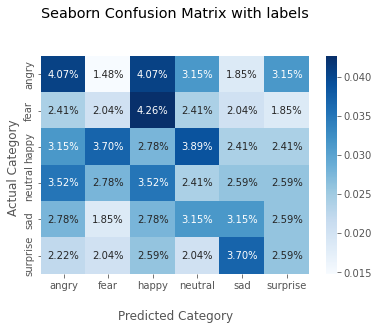

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix

%matplotlib inline
plt.close('all')

# Get the confusion matrix
cf_matrix = confusion_matrix(test_labels, y_pred)

ax = sns.heatmap(cf_matrix/np.sum(cf_matrix), annot=True, fmt='.2%', cmap='Blues')

ax.set_title('Seaborn Confusion Matrix with labels\n\n')
ax.set_xlabel('\nPredicted Category')
ax.set_ylabel('Actual Category ')

## Ticket labels - List must be in alphabetical order
ax.xaxis.set_ticklabels(['angry','fear', 'happy', 'neutral', 'sad', 'surprise'])
ax.yaxis.set_ticklabels(['angry','fear', 'happy', 'neutral', 'sad', 'surprise'])

## Display the visualization of the Confusion Matrix.
plt.show()



---



---

ANTRENARE INCA 50 EPOCHS

In [ ]:
output = '/content/drive/MyDrive/GitHub/licenta/outputs/output22'
checkpoint = '/content/drive/MyDrive/GitHub/licenta/outputs/output22/checkpoint3'
start_epoch = 51
model = '/content/drive/MyDrive/GitHub/licenta/outputs/output22/checkpoint2'

# load the model from disk
print("[INFO] loading {}...".format(model))
model = load_model(model)

for layer in base_model.layers[11:]:
  layer.trainable = True

print("[INFO] base model status... \n")
for i, layer in enumerate(base_model.layers):
  print(i, layer.name, layer.trainable)

print("\n\n[INFO] entire model status...\n\n")
for i, layer in enumerate(model.layers):
  print(i, layer.name, layer.trainable)

## Compile and fit model

print("[INFO] compiling model...")
opt = Adam(learning_rate = 1e-4)
model.compile(optimizer=opt, loss='categorical_crossentropy', metrics=['accuracy'])

# construct the set of callbacks
figPath = os.path.sep.join([output,"facial_emotion_recognition22_2.png"])
jsonPath = os.path.sep.join([output,"facial_emotion_recognition22_2.json"])
model_checkpoint_callback = tensorflow.keras.callbacks.ModelCheckpoint(filepath=checkpoint, save_weights_only=False, monitor='val_accuracy', mode='max', save_best_only=True)
callbacks = [model_checkpoint_callback, TrainingMonitor(figPath, jsonPath=jsonPath, startAt=start_epoch)]

model.fit(train_generator, steps_per_epoch = 4246 // 128, epochs = 100, validation_data = val_generator, validation_steps = 529 // 128, max_queue_size = 128 * 2, callbacks = callbacks, verbose = 1, initial_epoch = 50)

[INFO] loading /content/drive/MyDrive/GitHub/licenta/outputs/output22/checkpoint2...
[INFO] base model status... 

0 input_2 False
1 block1_conv1 False
2 block1_conv2 False
3 block1_pool False
4 block2_conv1 False
5 block2_conv2 False
6 block2_pool False
7 block3_conv1 False
8 block3_conv2 False
9 block3_conv3 False
10 block3_pool False
11 block4_conv1 True
12 block4_conv2 True
13 block4_conv3 True
14 block4_pool True
15 block5_conv1 True
16 block5_conv2 True
17 block5_conv3 True
18 block5_pool True


[INFO] entire model status...


0 vgg16 False
1 flatten_1 True
2 dense_2 True
3 dropout_1 True
4 dense_3 True
[INFO] compiling model...
Epoch 51/100
13/33 [==========>...................] - ETA: 46s - loss: 0.1590 - accuracy: 0.9495

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 81s 2s/step - loss: 0.1683 - accuracy: 0.9466 - val_loss: 0.5575 - val_accuracy: 0.8262
Epoch 52/100
10/33 [========>.....................] - ETA: 47s - loss: 0.1608 - accuracy: 0.9497

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 74s 2s/step - loss: 0.1548 - accuracy: 0.9507 - val_loss: 0.5401 - val_accuracy: 0.8320
Epoch 53/100
21/33 [==================>...........] - ETA: 24s - loss: 0.1451 - accuracy: 0.9580

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 68s 2s/step - loss: 0.1488 - accuracy: 0.9565 - val_loss: 0.5509 - val_accuracy: 0.8281
Epoch 54/100
 2/33 [>.............................] - ETA: 1:02 - loss: 0.1575 - accuracy: 0.9531

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 67s 2s/step - loss: 0.1500 - accuracy: 0.9543 - val_loss: 0.5695 - val_accuracy: 0.8281
Epoch 55/100
18/33 [===============>..............] - ETA: 27s - loss: 0.1429 - accuracy: 0.9577

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 66s 2s/step - loss: 0.1391 - accuracy: 0.9597 - val_loss: 0.5784 - val_accuracy: 0.8164
Epoch 56/100
16/33 [=============>................] - ETA: 32s - loss: 0.1335 - accuracy: 0.9619

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 66s 2s/step - loss: 0.1338 - accuracy: 0.9604 - val_loss: 0.5462 - val_accuracy: 0.8281
Epoch 57/100
11/33 [=========>....................] - ETA: 42s - loss: 0.1370 - accuracy: 0.9595

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 71s 2s/step - loss: 0.1300 - accuracy: 0.9624 - val_loss: 0.5388 - val_accuracy: 0.8340
Epoch 58/100
29/33 [=========================>....] - ETA: 7s - loss: 0.1296 - accuracy: 0.9606

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 67s 2s/step - loss: 0.1331 - accuracy: 0.9587 - val_loss: 0.5638 - val_accuracy: 0.8164
Epoch 59/100
20/33 [=================>............] - ETA: 25s - loss: 0.1218 - accuracy: 0.9680

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 67s 2s/step - loss: 0.1234 - accuracy: 0.9660 - val_loss: 0.5670 - val_accuracy: 0.8203
Epoch 60/100
11/33 [=========>....................] - ETA: 43s - loss: 0.1196 - accuracy: 0.9709

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 67s 2s/step - loss: 0.1339 - accuracy: 0.9602 - val_loss: 0.6144 - val_accuracy: 0.8242
Epoch 61/100
18/33 [===============>..............] - ETA: 27s - loss: 0.1254 - accuracy: 0.9609

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 66s 2s/step - loss: 0.1259 - accuracy: 0.9621 - val_loss: 0.6060 - val_accuracy: 0.8184
Epoch 62/100
15/33 [============>.................] - ETA: 33s - loss: 0.1304 - accuracy: 0.9598

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 66s 2s/step - loss: 0.1341 - accuracy: 0.9560 - val_loss: 0.5919 - val_accuracy: 0.8301
Epoch 63/100
24/33 [====================>.........] - ETA: 16s - loss: 0.1121 - accuracy: 0.9697

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 67s 2s/step - loss: 0.1145 - accuracy: 0.9696 - val_loss: 0.5735 - val_accuracy: 0.8223
Epoch 64/100
 1/33 [..............................] - ETA: 1:08 - loss: 0.1180 - accuracy: 0.9609

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 68s 2s/step - loss: 0.1200 - accuracy: 0.9652 - val_loss: 0.5989 - val_accuracy: 0.8262
Epoch 65/100
25/33 [=====================>........] - ETA: 14s - loss: 0.1092 - accuracy: 0.9674

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 65s 2s/step - loss: 0.1102 - accuracy: 0.9675 - val_loss: 0.5573 - val_accuracy: 0.8301
Epoch 66/100
29/33 [=========================>....] - ETA: 7s - loss: 0.1071 - accuracy: 0.9698

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 67s 2s/step - loss: 0.1078 - accuracy: 0.9702 - val_loss: 0.5792 - val_accuracy: 0.8223
Epoch 67/100
 5/33 [===>..........................] - ETA: 52s - loss: 0.1123 - accuracy: 0.9641

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 66s 2s/step - loss: 0.1118 - accuracy: 0.9684 - val_loss: 0.5959 - val_accuracy: 0.8125
Epoch 68/100
15/33 [============>.................] - ETA: 34s - loss: 0.0832 - accuracy: 0.9812

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 66s 2s/step - loss: 0.0995 - accuracy: 0.9728 - val_loss: 0.5861 - val_accuracy: 0.8242
Epoch 69/100
13/33 [==========>...................] - ETA: 39s - loss: 0.1005 - accuracy: 0.9724

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 66s 2s/step - loss: 0.0932 - accuracy: 0.9757 - val_loss: 0.6175 - val_accuracy: 0.8223
Epoch 70/100
 9/33 [=======>......................] - ETA: 45s - loss: 0.0790 - accuracy: 0.9844

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 66s 2s/step - loss: 0.0870 - accuracy: 0.9774 - val_loss: 0.5807 - val_accuracy: 0.8320
Epoch 71/100


/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 66s 2s/step - loss: 0.1037 - accuracy: 0.9704 - val_loss: 0.5737 - val_accuracy: 0.8301
Epoch 72/100
 9/33 [=======>......................] - ETA: 47s - loss: 0.0869 - accuracy: 0.9774

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 66s 2s/step - loss: 0.0871 - accuracy: 0.9750 - val_loss: 0.6268 - val_accuracy: 0.8223
Epoch 73/100
 2/33 [>.............................] - ETA: 59s - loss: 0.0940 - accuracy: 0.9648 

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 66s 2s/step - loss: 0.0905 - accuracy: 0.9750 - val_loss: 0.6200 - val_accuracy: 0.8320
Epoch 74/100
10/33 [========>.....................] - ETA: 44s - loss: 0.0887 - accuracy: 0.9711

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 65s 2s/step - loss: 0.0836 - accuracy: 0.9769 - val_loss: 0.6048 - val_accuracy: 0.8262
Epoch 75/100
15/33 [============>.................] - ETA: 31s - loss: 0.0852 - accuracy: 0.9741

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 68s 2s/step - loss: 0.0799 - accuracy: 0.9767 - val_loss: 0.5851 - val_accuracy: 0.8379
Epoch 76/100
23/33 [===================>..........] - ETA: 19s - loss: 0.0721 - accuracy: 0.9840

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 67s 2s/step - loss: 0.0741 - accuracy: 0.9815 - val_loss: 0.6129 - val_accuracy: 0.8281
Epoch 77/100
25/33 [=====================>........] - ETA: 15s - loss: 0.0851 - accuracy: 0.9759

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 66s 2s/step - loss: 0.0927 - accuracy: 0.9723 - val_loss: 0.7125 - val_accuracy: 0.8145
Epoch 78/100
25/33 [=====================>........] - ETA: 14s - loss: 0.1134 - accuracy: 0.9680

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 66s 2s/step - loss: 0.1047 - accuracy: 0.9706 - val_loss: 0.5702 - val_accuracy: 0.8379
Epoch 79/100
33/33 [==============================] - ETA: 0s - loss: 0.0829 - accuracy: 0.9760

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 66s 2s/step - loss: 0.0829 - accuracy: 0.9760 - val_loss: 0.6264 - val_accuracy: 0.8242
Epoch 80/100
19/33 [================>.............] - ETA: 27s - loss: 0.0894 - accuracy: 0.9745

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 66s 2s/step - loss: 0.0858 - accuracy: 0.9760 - val_loss: 0.5920 - val_accuracy: 0.8320
Epoch 81/100
21/33 [==================>...........] - ETA: 22s - loss: 0.0728 - accuracy: 0.9814

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 67s 2s/step - loss: 0.0747 - accuracy: 0.9808 - val_loss: 0.6299 - val_accuracy: 0.8359
Epoch 82/100
 8/33 [======>.......................] - ETA: 48s - loss: 0.0744 - accuracy: 0.9785

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 66s 2s/step - loss: 0.0739 - accuracy: 0.9818 - val_loss: 0.6361 - val_accuracy: 0.8359
Epoch 83/100
 8/33 [======>.......................] - ETA: 48s - loss: 0.0718 - accuracy: 0.9805

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 66s 2s/step - loss: 0.0757 - accuracy: 0.9811 - val_loss: 0.5922 - val_accuracy: 0.8340
Epoch 84/100
33/33 [==============================] - ETA: 0s - loss: 0.0732 - accuracy: 0.9791

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


INFO:tensorflow:Assets written to: /content/drive/MyDrive/GitHub/licenta/outputs/output22/checkpoint3/assets
33/33 [==============================] - 71s 2s/step - loss: 0.0732 - accuracy: 0.9791 - val_loss: 0.5999 - val_accuracy: 0.8418
Epoch 85/100
12/33 [=========>....................] - ETA: 40s - loss: 0.0643 - accuracy: 0.9824

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 66s 2s/step - loss: 0.0703 - accuracy: 0.9808 - val_loss: 0.6480 - val_accuracy: 0.8184
Epoch 86/100
26/33 [======================>.......] - ETA: 12s - loss: 0.0808 - accuracy: 0.9773

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 65s 2s/step - loss: 0.0786 - accuracy: 0.9784 - val_loss: 0.6267 - val_accuracy: 0.8340
Epoch 87/100
 7/33 [=====>........................] - ETA: 49s - loss: 0.0658 - accuracy: 0.9888

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 65s 2s/step - loss: 0.0674 - accuracy: 0.9849 - val_loss: 0.6871 - val_accuracy: 0.8184
Epoch 88/100


/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 64s 2s/step - loss: 0.0832 - accuracy: 0.9760 - val_loss: 0.6224 - val_accuracy: 0.8203
Epoch 89/100
29/33 [=========================>....] - ETA: 7s - loss: 0.0793 - accuracy: 0.9778

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 65s 2s/step - loss: 0.0763 - accuracy: 0.9789 - val_loss: 0.5961 - val_accuracy: 0.8340
Epoch 90/100
 5/33 [===>..........................] - ETA: 55s - loss: 0.0612 - accuracy: 0.9875

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 69s 2s/step - loss: 0.0674 - accuracy: 0.9832 - val_loss: 0.6418 - val_accuracy: 0.8438
Epoch 91/100
26/33 [======================>.......] - ETA: 13s - loss: 0.0680 - accuracy: 0.9820

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 66s 2s/step - loss: 0.0691 - accuracy: 0.9811 - val_loss: 0.6553 - val_accuracy: 0.8281
Epoch 92/100
23/33 [===================>..........] - ETA: 18s - loss: 0.0654 - accuracy: 0.9813

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 65s 2s/step - loss: 0.0672 - accuracy: 0.9806 - val_loss: 0.6218 - val_accuracy: 0.8262
Epoch 93/100
15/33 [============>.................] - ETA: 34s - loss: 0.0626 - accuracy: 0.9854

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 65s 2s/step - loss: 0.0653 - accuracy: 0.9840 - val_loss: 0.6250 - val_accuracy: 0.8301
Epoch 94/100
32/33 [============================>.] - ETA: 1s - loss: 0.0653 - accuracy: 0.9815

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 65s 2s/step - loss: 0.0652 - accuracy: 0.9815 - val_loss: 0.6449 - val_accuracy: 0.8242
Epoch 95/100
27/33 [=======================>......] - ETA: 11s - loss: 0.0586 - accuracy: 0.9864

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 66s 2s/step - loss: 0.0587 - accuracy: 0.9862 - val_loss: 0.6634 - val_accuracy: 0.8223
Epoch 96/100
26/33 [======================>.......] - ETA: 12s - loss: 0.0696 - accuracy: 0.9820

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 65s 2s/step - loss: 0.0686 - accuracy: 0.9820 - val_loss: 0.6487 - val_accuracy: 0.8203
Epoch 97/100
33/33 [==============================] - ETA: 0s - loss: 0.0590 - accuracy: 0.9864

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 65s 2s/step - loss: 0.0590 - accuracy: 0.9864 - val_loss: 0.6350 - val_accuracy: 0.8242
Epoch 98/100
33/33 [==============================] - ETA: 0s - loss: 0.0603 - accuracy: 0.9832

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 65s 2s/step - loss: 0.0603 - accuracy: 0.9832 - val_loss: 0.6820 - val_accuracy: 0.8301
Epoch 99/100
 9/33 [=======>......................] - ETA: 40s - loss: 0.0665 - accuracy: 0.9799

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 65s 2s/step - loss: 0.0567 - accuracy: 0.9857 - val_loss: 0.6318 - val_accuracy: 0.8359
Epoch 100/100
29/33 [=========================>....] - ETA: 7s - loss: 0.0538 - accuracy: 0.9859

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


33/33 [==============================] - 65s 2s/step - loss: 0.0536 - accuracy: 0.9862 - val_loss: 0.6148 - val_accuracy: 0.8379




---

TESTARE

Found 540 images belonging to 6 classes.
[INFO] loading /content/drive/MyDrive/GitHub/licenta/outputs/output22/checkpoint3...
4/4 [==============================] - 3s 658ms/step - loss: 0.5236 - accuracy: 0.8496
              precision    recall  f1-score   support

           0       0.18      0.20      0.19        96
           1       0.19      0.17      0.18        81
           2       0.16      0.15      0.16        99
           3       0.19      0.21      0.20        94
           4       0.19      0.17      0.18        88
           5       0.12      0.13      0.13        82

    accuracy                           0.17       540
   macro avg       0.17      0.17      0.17       540
weighted avg       0.17      0.17      0.17       540



[INFO] accuracy: 84.96


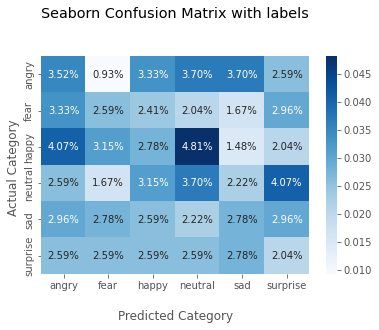

In [ ]:
# import the necessary packages
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import load_model
import argparse
from sklearn.metrics import classification_report
from sklearn.preprocessing import LabelBinarizer
import numpy as np

model = '/content/drive/MyDrive/GitHub/licenta/outputs/output22/checkpoint3'

test_datagen = ImageDataGenerator(rescale = 1 / 255.0)
test_generator = test_datagen.flow_from_directory( '/content/drive/MyDrive/GitHub/licenta/dataset_fer/test', target_size = (224, 224), batch_size = 128, class_mode = "categorical")

# load the model from disk
print("[INFO] loading {}...".format(model))
model = load_model(model)


# evaluate the network
(loss, acc) = model.evaluate(test_generator, steps = 540 // 128, max_queue_size = 128 * 2)

# get the ground truth of your data. 
test_labels  =test_generator.classes 

# predict the probability distribution of the data
predictions = model.predict(test_generator)

# get the class with highest probability for each sample
y_pred = np.argmax(predictions, axis=-1)

# get the classification report
print(classification_report(test_labels, y_pred))

print("\n\n[INFO] accuracy: {:.2f}".format(acc * 100))

import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix

%matplotlib inline
plt.close('all')

# Get the confusion matrix
cf_matrix = confusion_matrix(test_labels, y_pred)

ax = sns.heatmap(cf_matrix/np.sum(cf_matrix), annot=True, fmt='.2%', cmap='Blues')

ax.set_title('Seaborn Confusion Matrix with labels\n\n')
ax.set_xlabel('\nPredicted Category')
ax.set_ylabel('Actual Category ')

## Ticket labels - List must be in alphabetical order
ax.xaxis.set_ticklabels(['angry','fear', 'happy', 'neutral', 'sad', 'surprise'])
ax.yaxis.set_ticklabels(['angry','fear', 'happy', 'neutral', 'sad', 'surprise'])

## Display the visualization of the Confusion Matrix.
plt.show()

# Interferenta

Se va testa modelul pe cateva poze din fiecare clasa cu mine

In [4]:
class_labels = val_generator.class_indices
class_labels = {v: k for k, v in class_labels.items()}
print(class_labels)

{0: 'angry', 1: 'fear', 2: 'happy', 3: 'neutral', 4: 'sad', 5: 'suprise'}


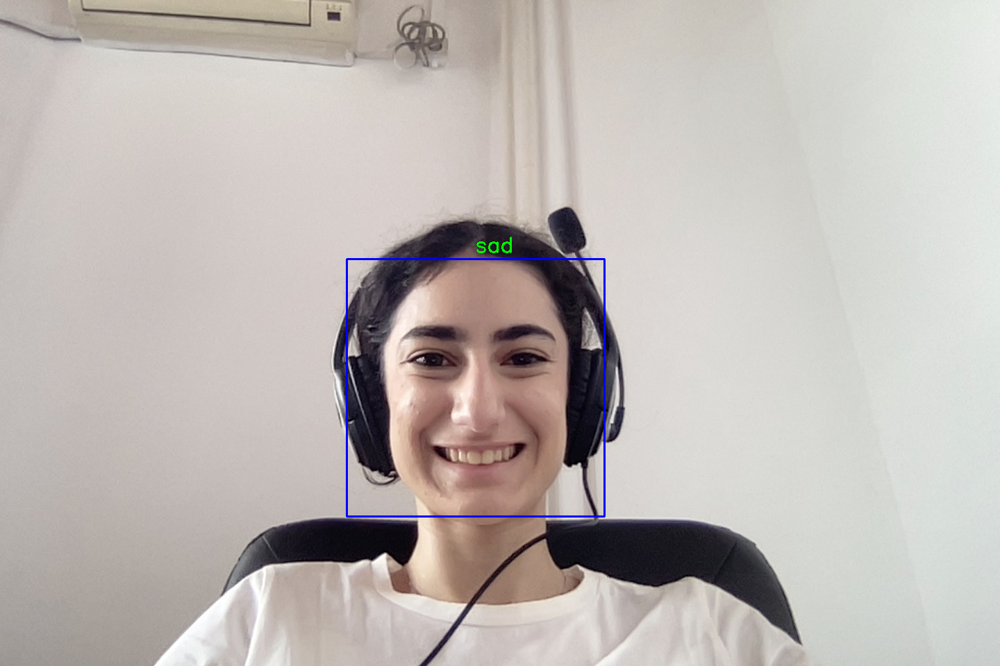

In [11]:
from keras.models import load_model
from keras.preprocessing import image
import numpy as np
import os
import cv2
import numpy as np
from os import listdir
from os.path import isfile, join
from keras.preprocessing.image import img_to_array
from google.colab.patches import cv2_imshow

# adaugare load model

classifier = load_model("/content/drive/MyDrive/GitHub/licenta/outputs/output22/checkpoint3")

face_classifier = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

def face_detector(img):
    faces = face_classifier.detectMultiScale(img, 1.3, 5)
    if faces is ():
        return (0,0,0,0), np.zeros((224,224), np.uint8), img
    allfaces = []   
    rects = []
    for (x,y,w,h) in faces:
        cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
        roi = img[y:y+h, x:x+w]
        roi = cv2.resize(roi, (224, 224), interpolation = cv2.INTER_AREA)
        allfaces.append(roi)
        rects.append((x,w,y,h))
    return rects, allfaces, img

img = cv2.imread("/content/drive/MyDrive/GitHub/licenta/poze_test_separat/happy.jpg")
rects, faces, image = face_detector(img)

i = 0
for face in faces:
    roi = face.astype("float") / 255.0
    roi = img_to_array(roi)
    roi = np.expand_dims(roi, axis=0)


    # make a prediction on the ROI, then lookup the class
    preds = classifier.predict(roi)[0]
    label = class_labels[preds.argmax()]   

    #Overlay our detected emotion on our pic
    label_position = (rects[i][0] + int((rects[i][1]/2)), abs(rects[i][2] - 10))
    i =+ 1
    cv2.putText(image, label, label_position , cv2.FONT_HERSHEY_SIMPLEX,1, (0,255,0), 2)
    
cv2_imshow(image)
cv2.waitKey(0)

cv2.destroyAllWindows()

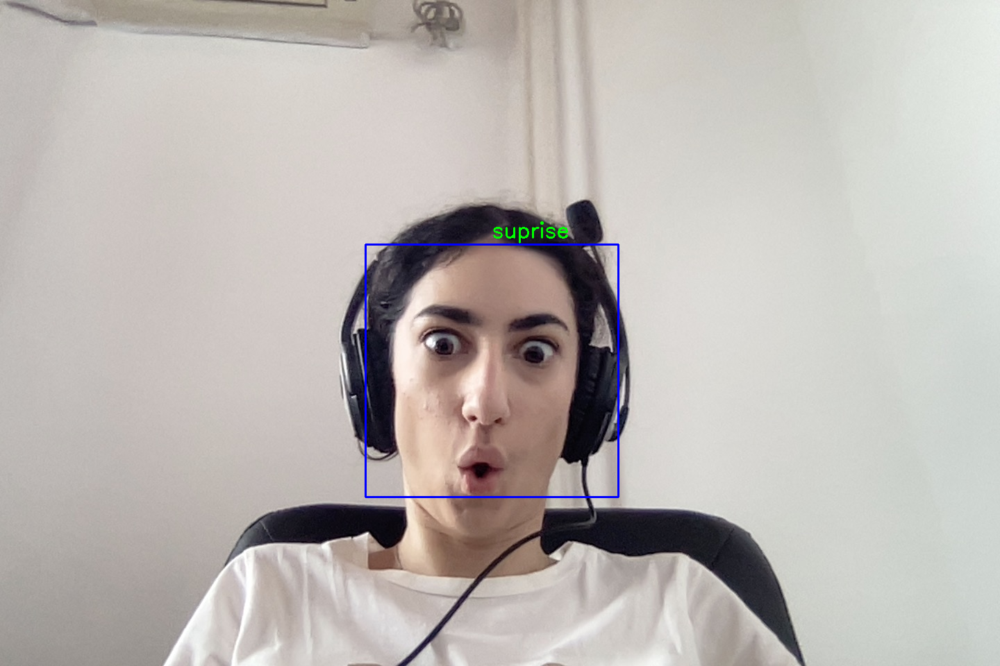

In [12]:
from keras.models import load_model
from keras.preprocessing import image
import numpy as np
import os
import cv2
import numpy as np
from os import listdir
from os.path import isfile, join
from keras.preprocessing.image import img_to_array
from google.colab.patches import cv2_imshow

# adaugare load model

classifier = load_model("/content/drive/MyDrive/GitHub/licenta/outputs/output22/checkpoint3")

face_classifier = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

def face_detector(img):
    faces = face_classifier.detectMultiScale(img, 1.3, 5)
    if faces is ():
        return (0,0,0,0), np.zeros((224,224), np.uint8), img
    allfaces = []   
    rects = []
    for (x,y,w,h) in faces:
        cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
        roi = img[y:y+h, x:x+w]
        roi = cv2.resize(roi, (224, 224), interpolation = cv2.INTER_AREA)
        allfaces.append(roi)
        rects.append((x,w,y,h))
    return rects, allfaces, img

img = cv2.imread("/content/drive/MyDrive/GitHub/licenta/poze_test_separat/sup.jpg")
rects, faces, image = face_detector(img)

i = 0
for face in faces:
    roi = face.astype("float") / 255.0
    roi = img_to_array(roi)
    roi = np.expand_dims(roi, axis=0)


    # make a prediction on the ROI, then lookup the class
    preds = classifier.predict(roi)[0]
    label = class_labels[preds.argmax()]   

    #Overlay our detected emotion on our pic
    label_position = (rects[i][0] + int((rects[i][1]/2)), abs(rects[i][2] - 10))
    i =+ 1
    cv2.putText(image, label, label_position , cv2.FONT_HERSHEY_SIMPLEX,1, (0,255,0), 2)
    
cv2_imshow(image)
cv2.waitKey(0)

cv2.destroyAllWindows()

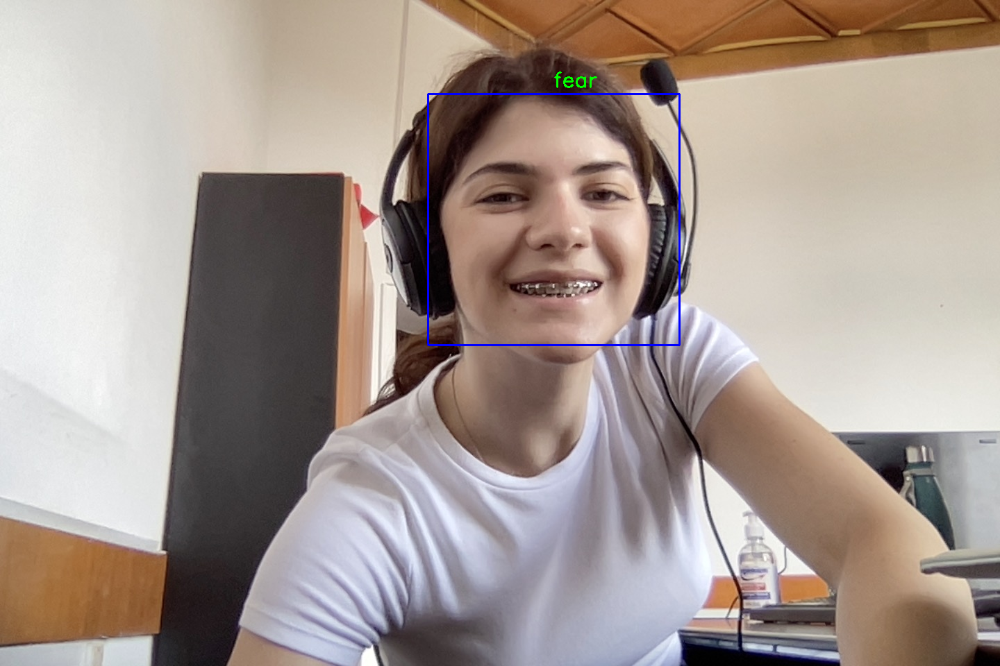

In [17]:
from keras.models import load_model
from keras.preprocessing import image
import numpy as np
import os
import cv2
import numpy as np
from os import listdir
from os.path import isfile, join
from keras.preprocessing.image import img_to_array
from google.colab.patches import cv2_imshow

# adaugare load model

classifier = load_model("/content/drive/MyDrive/GitHub/licenta/outputs/output22/checkpoint3")

face_classifier = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

def face_detector(img):
    faces = face_classifier.detectMultiScale(img, 1.3, 5)
    if faces is ():
        return (0,0,0,0), np.zeros((224,224), np.uint8), img
    allfaces = []   
    rects = []
    for (x,y,w,h) in faces:
        cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
        roi = img[y:y+h, x:x+w]
        roi = cv2.resize(roi, (224, 224), interpolation = cv2.INTER_AREA)
        allfaces.append(roi)
        rects.append((x,w,y,h))
    return rects, allfaces, img

img = cv2.imread("/content/drive/MyDrive/GitHub/licenta/poze_test_separat/cata.jpg")
rects, faces, image = face_detector(img)

i = 0
for face in faces:
    roi = face.astype("float") / 255.0
    roi = img_to_array(roi)
    roi = np.expand_dims(roi, axis=0)


    # make a prediction on the ROI, then lookup the class
    preds = classifier.predict(roi)[0]
    label = class_labels[preds.argmax()]   

    #Overlay our detected emotion on our pic
    label_position = (rects[i][0] + int((rects[i][1]/2)), abs(rects[i][2] - 10))
    i =+ 1
    cv2.putText(image, label, label_position , cv2.FONT_HERSHEY_SIMPLEX,1, (0,255,0), 2)
    
cv2_imshow(image)
cv2.waitKey(0)

cv2.destroyAllWindows()

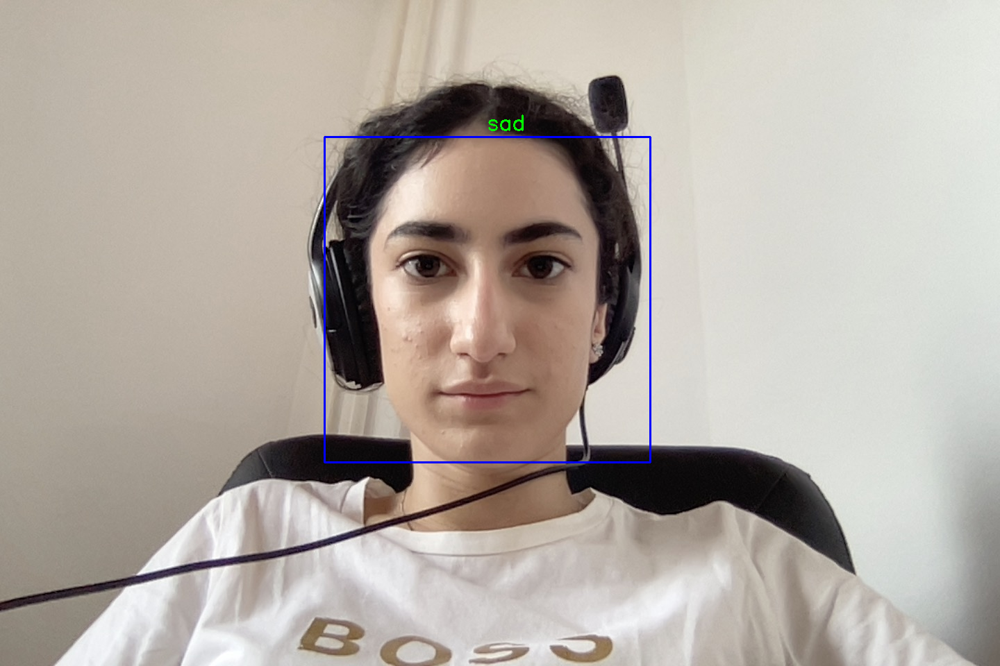

In [9]:
from keras.models import load_model
from keras.preprocessing import image
import numpy as np
import os
import cv2
import numpy as np
from os import listdir
from os.path import isfile, join
from keras.preprocessing.image import img_to_array
from google.colab.patches import cv2_imshow

# adaugare load model

classifier = load_model("/content/drive/MyDrive/GitHub/licenta/outputs/output22/checkpoint3")

face_classifier = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

def face_detector(img):
    faces = face_classifier.detectMultiScale(img, 1.3, 5)
    if faces is ():
        return (0,0,0,0), np.zeros((224,224), np.uint8), img
    allfaces = []   
    rects = []
    for (x,y,w,h) in faces:
        cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
        roi = img[y:y+h, x:x+w]
        roi = cv2.resize(roi, (224, 224), interpolation = cv2.INTER_AREA)
        allfaces.append(roi)
        rects.append((x,w,y,h))
    return rects, allfaces, img

img = cv2.imread("/content/drive/MyDrive/GitHub/licenta/poze_test_separat/poza1.jpg")
rects, faces, image = face_detector(img)

i = 0
for face in faces:
    roi = face.astype("float") / 255.0
    roi = img_to_array(roi)
    roi = np.expand_dims(roi, axis=0)


    # make a prediction on the ROI, then lookup the class
    preds = classifier.predict(roi)[0]
    label = class_labels[preds.argmax()]   

    #Overlay our detected emotion on our pic
    label_position = (rects[i][0] + int((rects[i][1]/2)), abs(rects[i][2] - 10))
    i =+ 1
    cv2.putText(image, label, label_position , cv2.FONT_HERSHEY_SIMPLEX,1, (0,255,0), 2)
    
cv2_imshow(image)
cv2.waitKey(0)

cv2.destroyAllWindows()

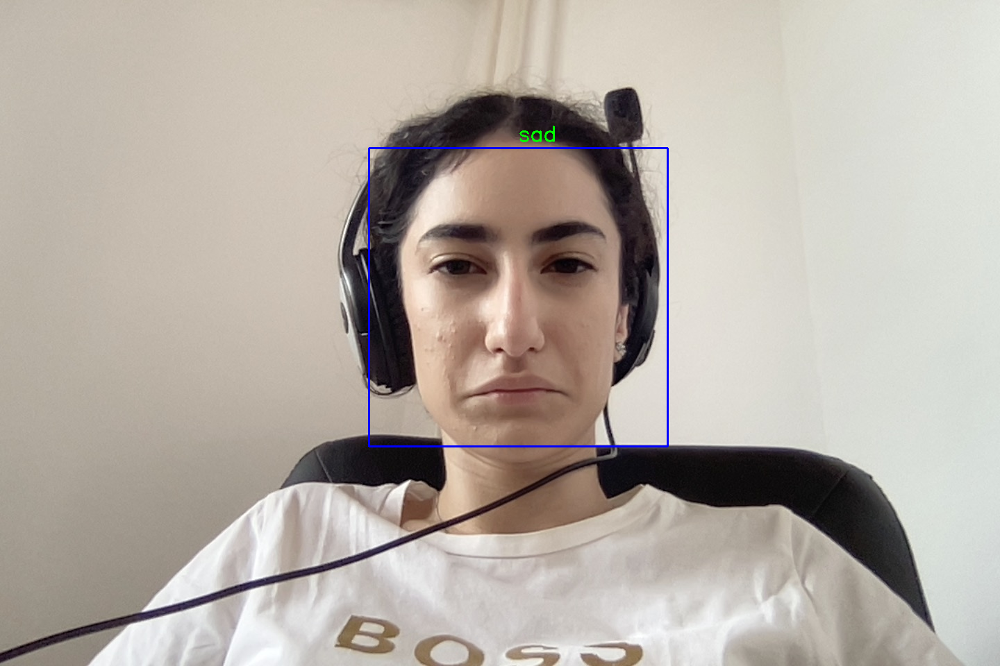

In [12]:
from keras.models import load_model
from keras.preprocessing import image
import numpy as np
import os
import cv2
import numpy as np
from os import listdir
from os.path import isfile, join
from keras.preprocessing.image import img_to_array
from google.colab.patches import cv2_imshow

# adaugare load model

classifier = load_model("/content/drive/MyDrive/GitHub/licenta/outputs/output22/checkpoint3")

face_classifier = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

def face_detector(img):
    faces = face_classifier.detectMultiScale(img, 1.3, 5)
    if faces is ():
        return (0,0,0,0), np.zeros((224,224), np.uint8), img
    allfaces = []   
    rects = []
    for (x,y,w,h) in faces:
        cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
        roi = img[y:y+h, x:x+w]
        roi = cv2.resize(roi, (224, 224), interpolation = cv2.INTER_AREA)
        allfaces.append(roi)
        rects.append((x,w,y,h))
    return rects, allfaces, img

img = cv2.imread("/content/drive/MyDrive/GitHub/licenta/poze_test_separat/poza2.jpg")
rects, faces, image = face_detector(img)

i = 0
for face in faces:
    roi = face.astype("float") / 255.0
    roi = img_to_array(roi)
    roi = np.expand_dims(roi, axis=0)


    # make a prediction on the ROI, then lookup the class
    preds = classifier.predict(roi)[0]
    label = class_labels[preds.argmax()]   

    #Overlay our detected emotion on our pic
    label_position = (rects[i][0] + int((rects[i][1]/2)), abs(rects[i][2] - 10))
    i =+ 1
    cv2.putText(image, label, label_position , cv2.FONT_HERSHEY_SIMPLEX,1, (0,255,0), 2)
    
cv2_imshow(image)
cv2.waitKey(0)

cv2.destroyAllWindows()

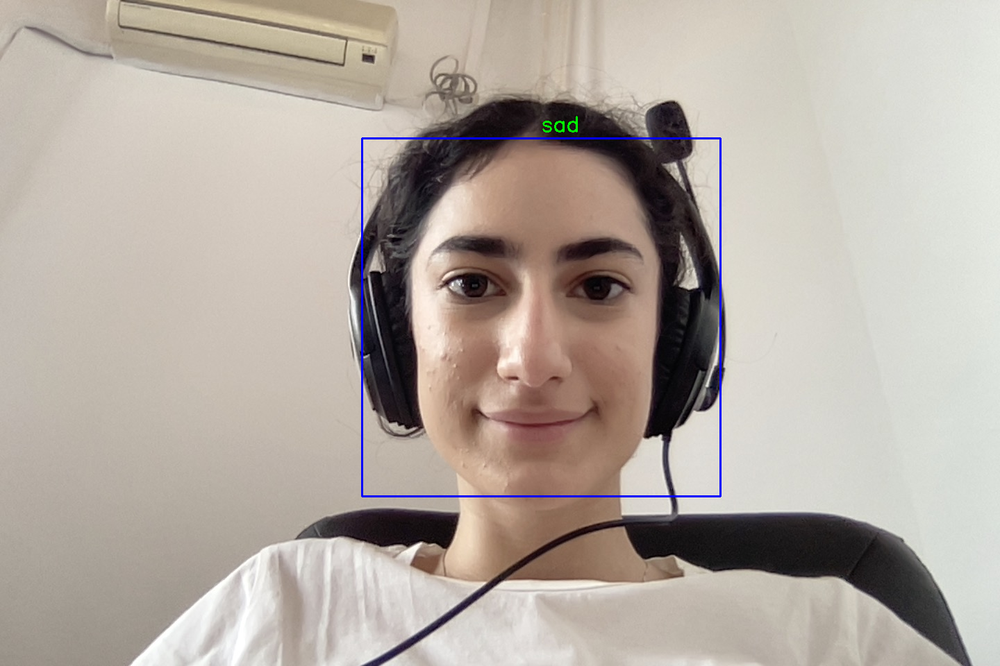

In [21]:
from keras.models import load_model
from keras.preprocessing import image
import numpy as np
import os
import cv2
import numpy as np
from os import listdir
from os.path import isfile, join
from keras.preprocessing.image import img_to_array
from google.colab.patches import cv2_imshow

# adaugare load model

classifier = load_model("/content/drive/MyDrive/GitHub/licenta/outputs/output22/checkpoint3")

face_classifier = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

def face_detector(img):
    faces = face_classifier.detectMultiScale(img, 1.3, 5)
    if faces is ():
        return (0,0,0,0), np.zeros((224,224), np.uint8), img
    allfaces = []   
    rects = []
    for (x,y,w,h) in faces:
        cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
        roi = img[y:y+h, x:x+w]
        roi = cv2.resize(roi, (224, 224), interpolation = cv2.INTER_AREA)
        allfaces.append(roi)
        rects.append((x,w,y,h))
    return rects, allfaces, img

img = cv2.imread("/content/drive/MyDrive/GitHub/licenta/poze_test_separat/poza3.jpg")
rects, faces, image = face_detector(img)

i = 0
for face in faces:
    roi = face.astype("float") / 255.0
    roi = img_to_array(roi)
    roi = np.expand_dims(roi, axis=0)


    # make a prediction on the ROI, then lookup the class
    preds = classifier.predict(roi)[0]
    label = class_labels[preds.argmax()]   

    #Overlay our detected emotion on our pic
    label_position = (rects[i][0] + int((rects[i][1]/2)), abs(rects[i][2] - 10))
    i =+ 1
    cv2.putText(image, label, label_position , cv2.FONT_HERSHEY_SIMPLEX,1, (0,255,0), 2)
    
cv2_imshow(image)
cv2.waitKey(0)

cv2.destroyAllWindows()

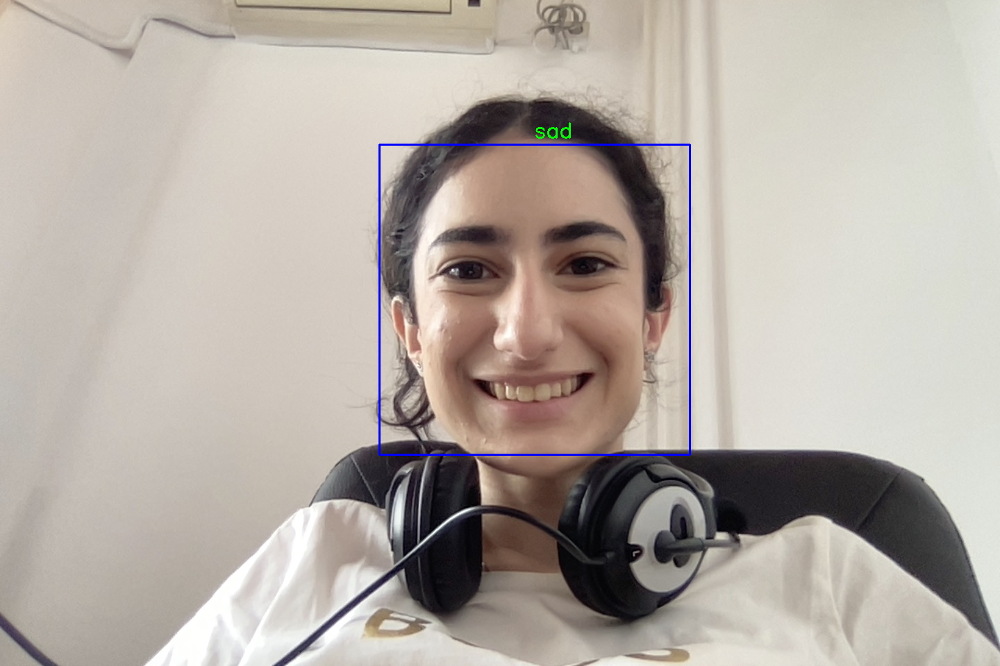

In [23]:
from keras.models import load_model
from keras.preprocessing import image
import numpy as np
import os
import cv2
import numpy as np
from os import listdir
from os.path import isfile, join
from keras.preprocessing.image import img_to_array
from google.colab.patches import cv2_imshow

# adaugare load model

classifier = load_model("/content/drive/MyDrive/GitHub/licenta/outputs/output22/checkpoint3")

face_classifier = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

def face_detector(img):
    faces = face_classifier.detectMultiScale(img, 1.3, 5)
    if faces is ():
        return (0,0,0,0), np.zeros((224,224), np.uint8), img
    allfaces = []   
    rects = []
    for (x,y,w,h) in faces:
        cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
        roi = img[y:y+h, x:x+w]
        roi = cv2.resize(roi, (224, 224), interpolation = cv2.INTER_AREA)
        allfaces.append(roi)
        rects.append((x,w,y,h))
    return rects, allfaces, img

img = cv2.imread("/content/drive/MyDrive/GitHub/licenta/poze_test_separat/poza4.jpg")
rects, faces, image = face_detector(img)

i = 0
for face in faces:
    roi = face.astype("float") / 255.0
    roi = img_to_array(roi)
    roi = np.expand_dims(roi, axis=0)


    # make a prediction on the ROI, then lookup the class
    preds = classifier.predict(roi)[0]
    label = class_labels[preds.argmax()]   

    #Overlay our detected emotion on our pic
    label_position = (rects[i][0] + int((rects[i][1]/2)), abs(rects[i][2] - 10))
    i =+ 1
    cv2.putText(image, label, label_position , cv2.FONT_HERSHEY_SIMPLEX,1, (0,255,0), 2)
    
cv2_imshow(image)
cv2.waitKey(0)

cv2.destroyAllWindows()

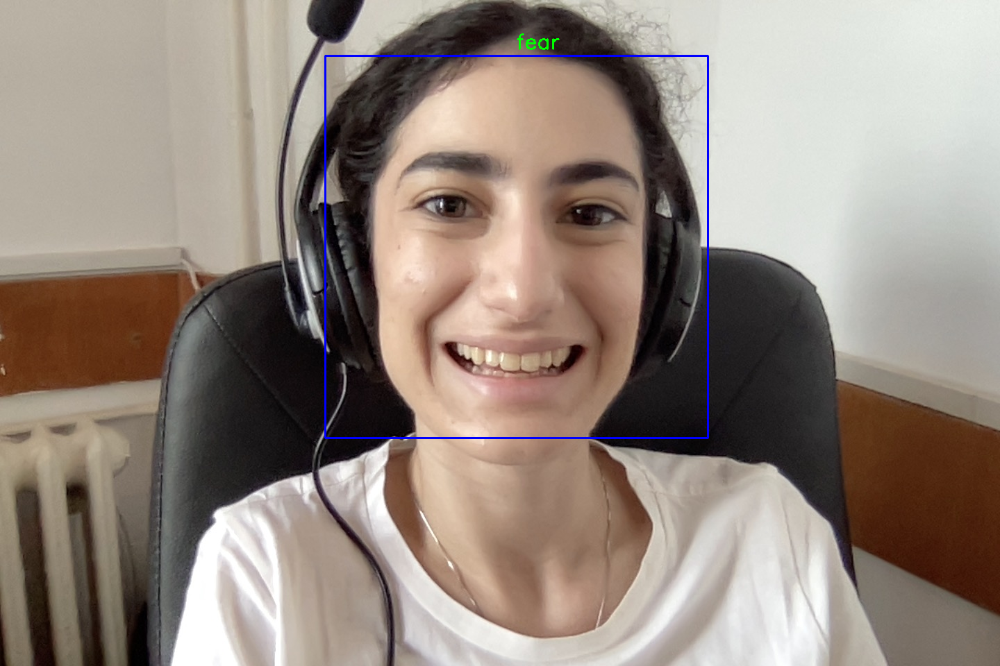

In [24]:
from keras.models import load_model
from keras.preprocessing import image
import numpy as np
import os
import cv2
import numpy as np
from os import listdir
from os.path import isfile, join
from keras.preprocessing.image import img_to_array
from google.colab.patches import cv2_imshow

# adaugare load model

classifier = load_model("/content/drive/MyDrive/GitHub/licenta/outputs/output22/checkpoint3")

face_classifier = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

def face_detector(img):
    faces = face_classifier.detectMultiScale(img, 1.3, 5)
    if faces is ():
        return (0,0,0,0), np.zeros((224,224), np.uint8), img
    allfaces = []   
    rects = []
    for (x,y,w,h) in faces:
        cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
        roi = img[y:y+h, x:x+w]
        roi = cv2.resize(roi, (224, 224), interpolation = cv2.INTER_AREA)
        allfaces.append(roi)
        rects.append((x,w,y,h))
    return rects, allfaces, img

img = cv2.imread("/content/drive/MyDrive/GitHub/licenta/poze_test_separat/poza5.jpg")
rects, faces, image = face_detector(img)

i = 0
for face in faces:
    roi = face.astype("float") / 255.0
    roi = img_to_array(roi)
    roi = np.expand_dims(roi, axis=0)


    # make a prediction on the ROI, then lookup the class
    preds = classifier.predict(roi)[0]
    label = class_labels[preds.argmax()]   

    #Overlay our detected emotion on our pic
    label_position = (rects[i][0] + int((rects[i][1]/2)), abs(rects[i][2] - 10))
    i =+ 1
    cv2.putText(image, label, label_position , cv2.FONT_HERSHEY_SIMPLEX,1, (0,255,0), 2)
    
cv2_imshow(image)
cv2.waitKey(0)

cv2.destroyAllWindows()

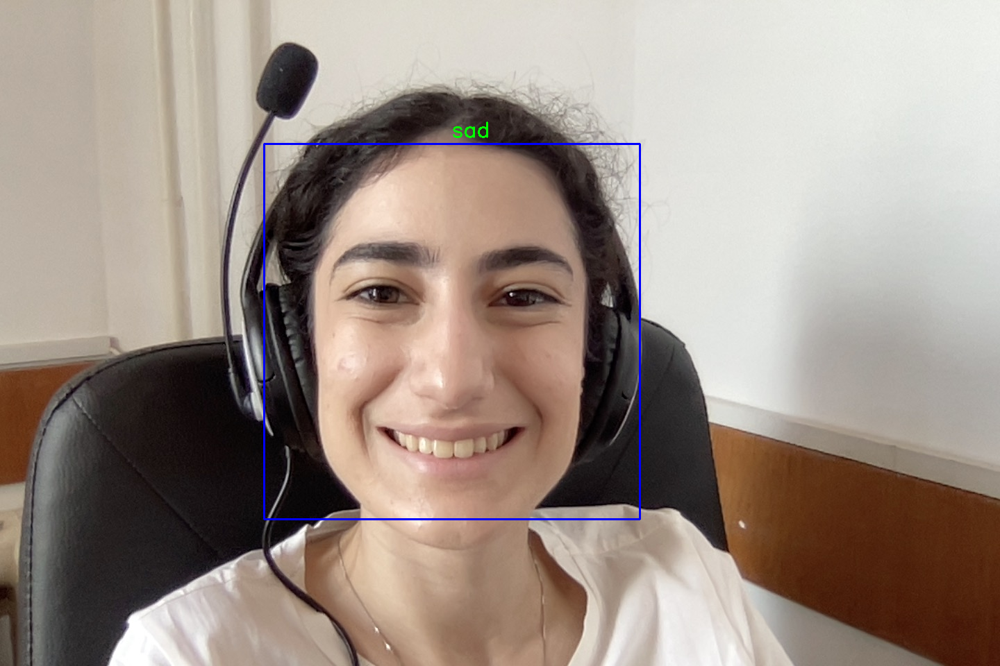

In [25]:
from keras.models import load_model
from keras.preprocessing import image
import numpy as np
import os
import cv2
import numpy as np
from os import listdir
from os.path import isfile, join
from keras.preprocessing.image import img_to_array
from google.colab.patches import cv2_imshow

# adaugare load model

classifier = load_model("/content/drive/MyDrive/GitHub/licenta/outputs/output22/checkpoint3")

face_classifier = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

def face_detector(img):
    faces = face_classifier.detectMultiScale(img, 1.3, 5)
    if faces is ():
        return (0,0,0,0), np.zeros((224,224), np.uint8), img
    allfaces = []   
    rects = []
    for (x,y,w,h) in faces:
        cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
        roi = img[y:y+h, x:x+w]
        roi = cv2.resize(roi, (224, 224), interpolation = cv2.INTER_AREA)
        allfaces.append(roi)
        rects.append((x,w,y,h))
    return rects, allfaces, img

img = cv2.imread("/content/drive/MyDrive/GitHub/licenta/poze_test_separat/poza6.jpg")
rects, faces, image = face_detector(img)

i = 0
for face in faces:
    roi = face.astype("float") / 255.0
    roi = img_to_array(roi)
    roi = np.expand_dims(roi, axis=0)


    # make a prediction on the ROI, then lookup the class
    preds = classifier.predict(roi)[0]
    label = class_labels[preds.argmax()]   

    #Overlay our detected emotion on our pic
    label_position = (rects[i][0] + int((rects[i][1]/2)), abs(rects[i][2] - 10))
    i =+ 1
    cv2.putText(image, label, label_position , cv2.FONT_HERSHEY_SIMPLEX,1, (0,255,0), 2)
    
cv2_imshow(image)
cv2.waitKey(0)

cv2.destroyAllWindows()

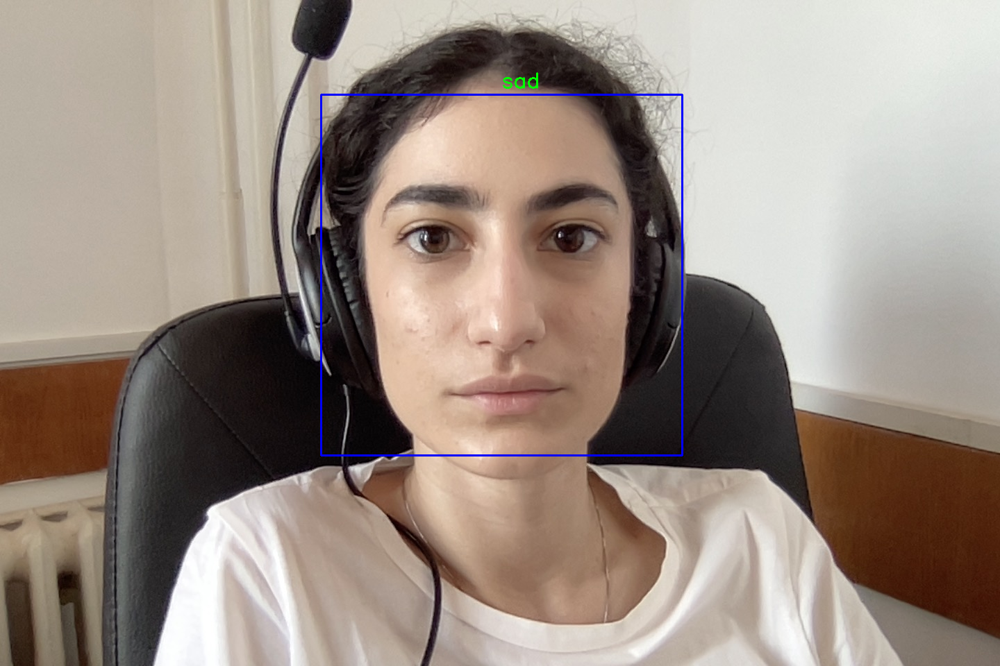

In [26]:
from keras.models import load_model
from keras.preprocessing import image
import numpy as np
import os
import cv2
import numpy as np
from os import listdir
from os.path import isfile, join
from keras.preprocessing.image import img_to_array
from google.colab.patches import cv2_imshow

# adaugare load model

classifier = load_model("/content/drive/MyDrive/GitHub/licenta/outputs/output22/checkpoint3")

face_classifier = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

def face_detector(img):
    faces = face_classifier.detectMultiScale(img, 1.3, 5)
    if faces is ():
        return (0,0,0,0), np.zeros((224,224), np.uint8), img
    allfaces = []   
    rects = []
    for (x,y,w,h) in faces:
        cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
        roi = img[y:y+h, x:x+w]
        roi = cv2.resize(roi, (224, 224), interpolation = cv2.INTER_AREA)
        allfaces.append(roi)
        rects.append((x,w,y,h))
    return rects, allfaces, img

img = cv2.imread("/content/drive/MyDrive/GitHub/licenta/poze_test_separat/poza7.jpg")
rects, faces, image = face_detector(img)

i = 0
for face in faces:
    roi = face.astype("float") / 255.0
    roi = img_to_array(roi)
    roi = np.expand_dims(roi, axis=0)


    # make a prediction on the ROI, then lookup the class
    preds = classifier.predict(roi)[0]
    label = class_labels[preds.argmax()]   

    #Overlay our detected emotion on our pic
    label_position = (rects[i][0] + int((rects[i][1]/2)), abs(rects[i][2] - 10))
    i =+ 1
    cv2.putText(image, label, label_position , cv2.FONT_HERSHEY_SIMPLEX,1, (0,255,0), 2)
    
cv2_imshow(image)
cv2.waitKey(0)

cv2.destroyAllWindows()

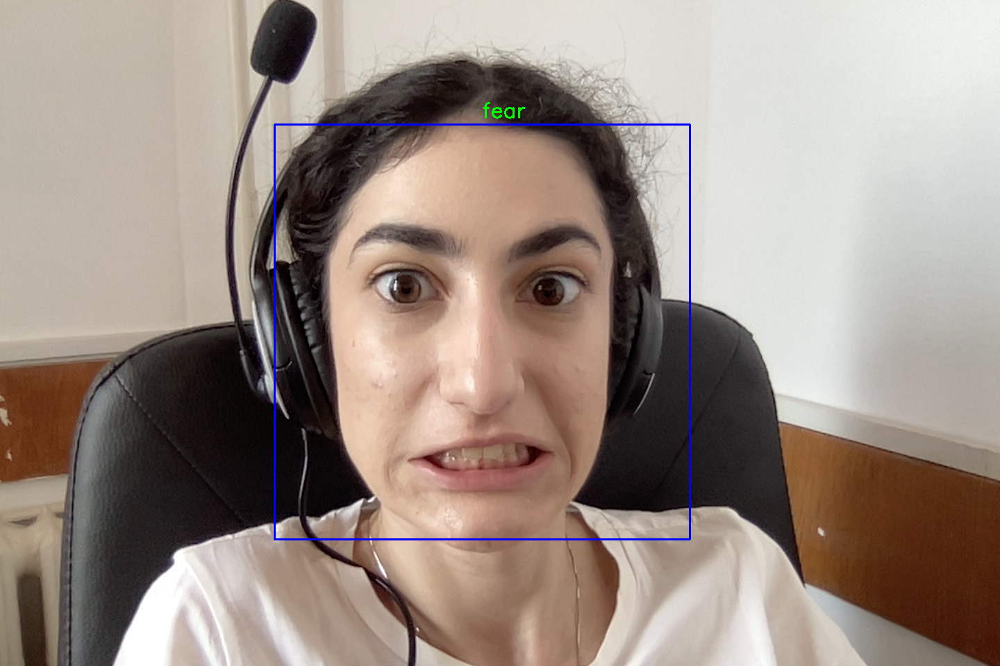

In [27]:
from keras.models import load_model
from keras.preprocessing import image
import numpy as np
import os
import cv2
import numpy as np
from os import listdir
from os.path import isfile, join
from keras.preprocessing.image import img_to_array
from google.colab.patches import cv2_imshow

# adaugare load model

classifier = load_model("/content/drive/MyDrive/GitHub/licenta/outputs/output22/checkpoint3")

face_classifier = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

def face_detector(img):
    faces = face_classifier.detectMultiScale(img, 1.3, 5)
    if faces is ():
        return (0,0,0,0), np.zeros((224,224), np.uint8), img
    allfaces = []   
    rects = []
    for (x,y,w,h) in faces:
        cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
        roi = img[y:y+h, x:x+w]
        roi = cv2.resize(roi, (224, 224), interpolation = cv2.INTER_AREA)
        allfaces.append(roi)
        rects.append((x,w,y,h))
    return rects, allfaces, img

img = cv2.imread("/content/drive/MyDrive/GitHub/licenta/poze_test_separat/poza8.jpg")
rects, faces, image = face_detector(img)

i = 0
for face in faces:
    roi = face.astype("float") / 255.0
    roi = img_to_array(roi)
    roi = np.expand_dims(roi, axis=0)


    # make a prediction on the ROI, then lookup the class
    preds = classifier.predict(roi)[0]
    label = class_labels[preds.argmax()]   

    #Overlay our detected emotion on our pic
    label_position = (rects[i][0] + int((rects[i][1]/2)), abs(rects[i][2] - 10))
    i =+ 1
    cv2.putText(image, label, label_position , cv2.FONT_HERSHEY_SIMPLEX,1, (0,255,0), 2)
    
cv2_imshow(image)
cv2.waitKey(0)

cv2.destroyAllWindows()

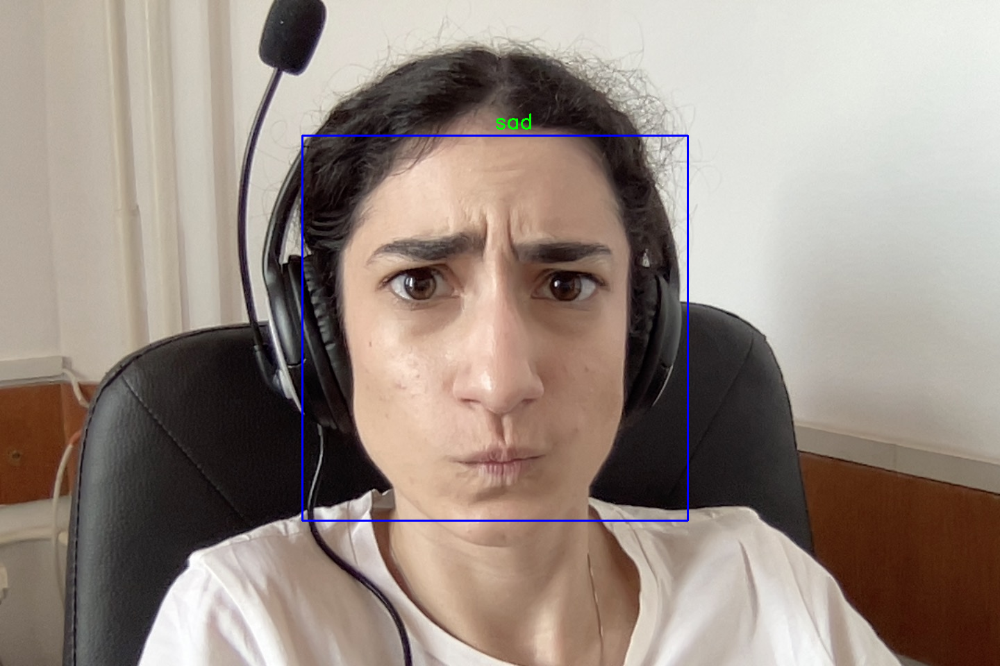

In [28]:
from keras.models import load_model
from keras.preprocessing import image
import numpy as np
import os
import cv2
import numpy as np
from os import listdir
from os.path import isfile, join
from keras.preprocessing.image import img_to_array
from google.colab.patches import cv2_imshow

# adaugare load model

classifier = load_model("/content/drive/MyDrive/GitHub/licenta/outputs/output22/checkpoint3")

face_classifier = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

def face_detector(img):
    faces = face_classifier.detectMultiScale(img, 1.3, 5)
    if faces is ():
        return (0,0,0,0), np.zeros((224,224), np.uint8), img
    allfaces = []   
    rects = []
    for (x,y,w,h) in faces:
        cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
        roi = img[y:y+h, x:x+w]
        roi = cv2.resize(roi, (224, 224), interpolation = cv2.INTER_AREA)
        allfaces.append(roi)
        rects.append((x,w,y,h))
    return rects, allfaces, img

img = cv2.imread("/content/drive/MyDrive/GitHub/licenta/poze_test_separat/poza9.jpg")
rects, faces, image = face_detector(img)

i = 0
for face in faces:
    roi = face.astype("float") / 255.0
    roi = img_to_array(roi)
    roi = np.expand_dims(roi, axis=0)


    # make a prediction on the ROI, then lookup the class
    preds = classifier.predict(roi)[0]
    label = class_labels[preds.argmax()]   

    #Overlay our detected emotion on our pic
    label_position = (rects[i][0] + int((rects[i][1]/2)), abs(rects[i][2] - 10))
    i =+ 1
    cv2.putText(image, label, label_position , cv2.FONT_HERSHEY_SIMPLEX,1, (0,255,0), 2)
    
cv2_imshow(image)
cv2.waitKey(0)

cv2.destroyAllWindows()

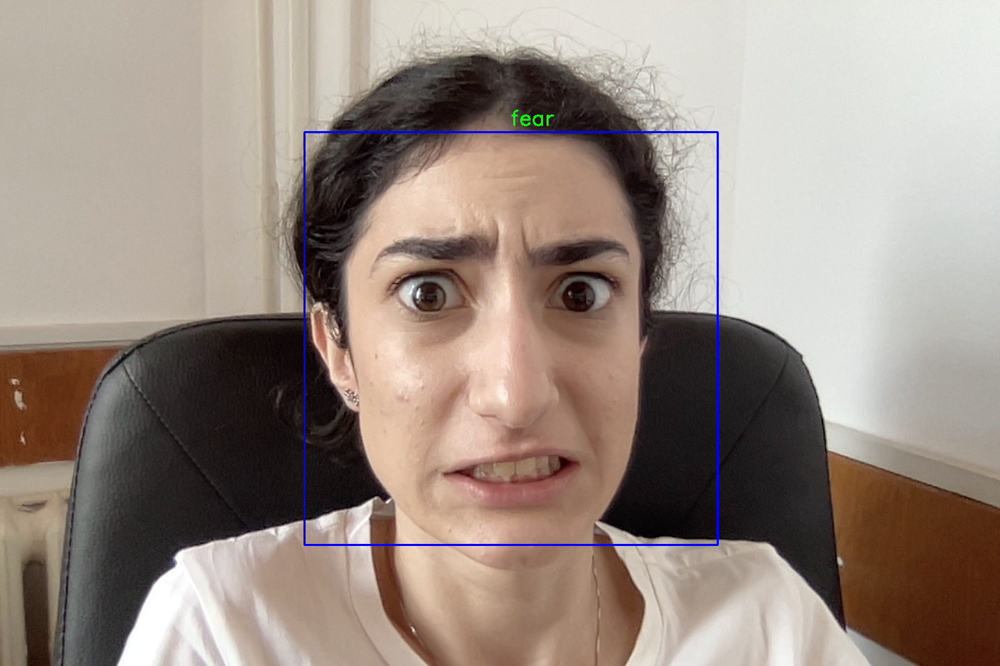

In [31]:
from keras.models import load_model
from keras.preprocessing import image
import numpy as np
import os
import cv2
import numpy as np
from os import listdir
from os.path import isfile, join
from keras.preprocessing.image import img_to_array
from google.colab.patches import cv2_imshow

# adaugare load model

classifier = load_model("/content/drive/MyDrive/GitHub/licenta/outputs/output22/checkpoint3")

face_classifier = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

def face_detector(img):
    faces = face_classifier.detectMultiScale(img, 1.3, 5)
    if faces is ():
        return (0,0,0,0), np.zeros((224,224), np.uint8), img
    allfaces = []   
    rects = []
    for (x,y,w,h) in faces:
        cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
        roi = img[y:y+h, x:x+w]
        roi = cv2.resize(roi, (224, 224), interpolation = cv2.INTER_AREA)
        allfaces.append(roi)
        rects.append((x,w,y,h))
    return rects, allfaces, img

img = cv2.imread("/content/drive/MyDrive/GitHub/licenta/poze_test_separat/poza10.jpg")
rects, faces, image = face_detector(img)

i = 0
for face in faces:
    roi = face.astype("float") / 255.0
    roi = img_to_array(roi)
    roi = np.expand_dims(roi, axis=0)


    # make a prediction on the ROI, then lookup the class
    preds = classifier.predict(roi)[0]
    label = class_labels[preds.argmax()]   

    #Overlay our detected emotion on our pic
    label_position = (rects[i][0] + int((rects[i][1]/2)), abs(rects[i][2] - 10))
    i =+ 1
    cv2.putText(image, label, label_position , cv2.FONT_HERSHEY_SIMPLEX,1, (0,255,0), 2)
    
cv2_imshow(image)
cv2.waitKey(0)

cv2.destroyAllWindows()

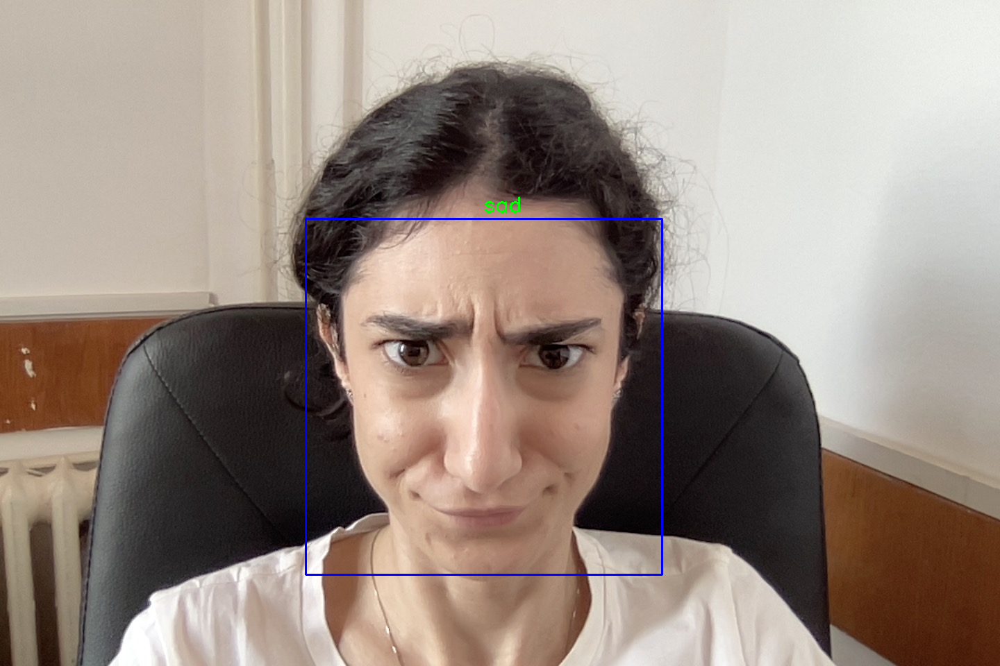

In [33]:
from keras.models import load_model
from keras.preprocessing import image
import numpy as np
import os
import cv2
import numpy as np
from os import listdir
from os.path import isfile, join
from keras.preprocessing.image import img_to_array
from google.colab.patches import cv2_imshow

# adaugare load model

classifier = load_model("/content/drive/MyDrive/GitHub/licenta/outputs/output22/checkpoint3")

face_classifier = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

def face_detector(img):
    faces = face_classifier.detectMultiScale(img, 1.3, 5)
    if faces is ():
        return (0,0,0,0), np.zeros((224,224), np.uint8), img
    allfaces = []   
    rects = []
    for (x,y,w,h) in faces:
        cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
        roi = img[y:y+h, x:x+w]
        roi = cv2.resize(roi, (224, 224), interpolation = cv2.INTER_AREA)
        allfaces.append(roi)
        rects.append((x,w,y,h))
    return rects, allfaces, img

img = cv2.imread("/content/drive/MyDrive/GitHub/licenta/poze_test_separat/poza11.jpg")
rects, faces, image = face_detector(img)

i = 0
for face in faces:
    roi = face.astype("float") / 255.0
    roi = img_to_array(roi)
    roi = np.expand_dims(roi, axis=0)


    # make a prediction on the ROI, then lookup the class
    preds = classifier.predict(roi)[0]
    label = class_labels[preds.argmax()]   

    #Overlay our detected emotion on our pic
    label_position = (rects[i][0] + int((rects[i][1]/2)), abs(rects[i][2] - 10))
    i =+ 1
    cv2.putText(image, label, label_position , cv2.FONT_HERSHEY_SIMPLEX,1, (0,255,0), 2)
    
cv2_imshow(image)
cv2.waitKey(0)

cv2.destroyAllWindows()

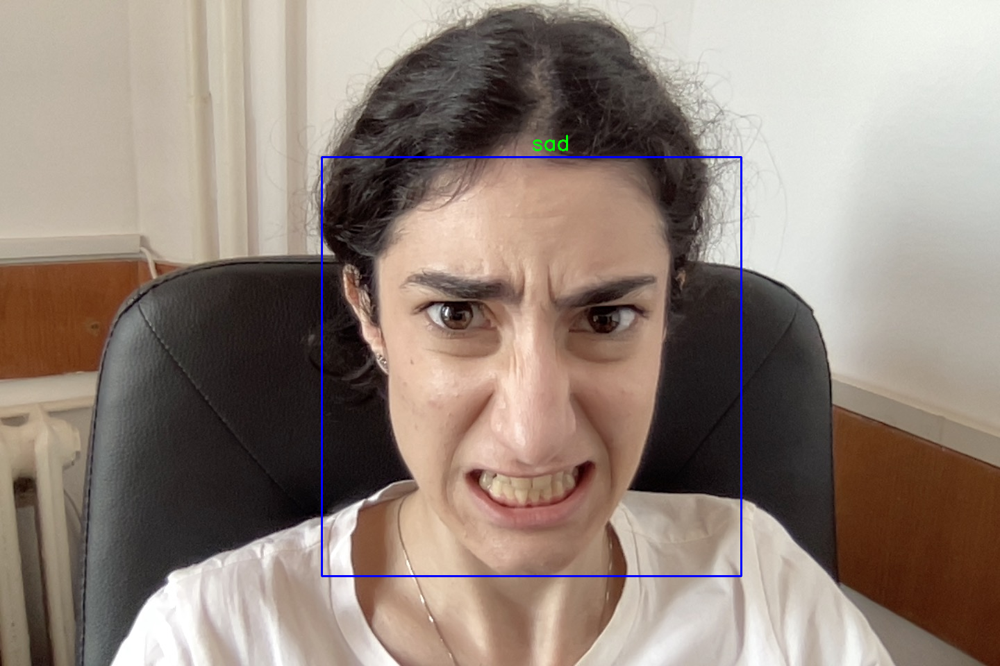

In [36]:
from keras.models import load_model
from keras.preprocessing import image
import numpy as np
import os
import cv2
import numpy as np
from os import listdir
from os.path import isfile, join
from keras.preprocessing.image import img_to_array
from google.colab.patches import cv2_imshow

# adaugare load model

classifier = load_model("/content/drive/MyDrive/GitHub/licenta/outputs/output22/checkpoint3")

face_classifier = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

def face_detector(img):
    faces = face_classifier.detectMultiScale(img, 1.3, 5)
    if faces is ():
        return (0,0,0,0), np.zeros((224,224), np.uint8), img
    allfaces = []   
    rects = []
    for (x,y,w,h) in faces:
        cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
        roi = img[y:y+h, x:x+w]
        roi = cv2.resize(roi, (224, 224), interpolation = cv2.INTER_AREA)
        allfaces.append(roi)
        rects.append((x,w,y,h))
    return rects, allfaces, img

img = cv2.imread("/content/drive/MyDrive/GitHub/licenta/poze_test_separat/poza12.jpg")
rects, faces, image = face_detector(img)

i = 0
for face in faces:
    roi = face.astype("float") / 255.0
    roi = img_to_array(roi)
    roi = np.expand_dims(roi, axis=0)


    # make a prediction on the ROI, then lookup the class
    preds = classifier.predict(roi)[0]
    label = class_labels[preds.argmax()]   

    #Overlay our detected emotion on our pic
    label_position = (rects[i][0] + int((rects[i][1]/2)), abs(rects[i][2] - 10))
    i =+ 1
    cv2.putText(image, label, label_position , cv2.FONT_HERSHEY_SIMPLEX,1, (0,255,0), 2)
    
cv2_imshow(image)
cv2.waitKey(0)

cv2.destroyAllWindows()

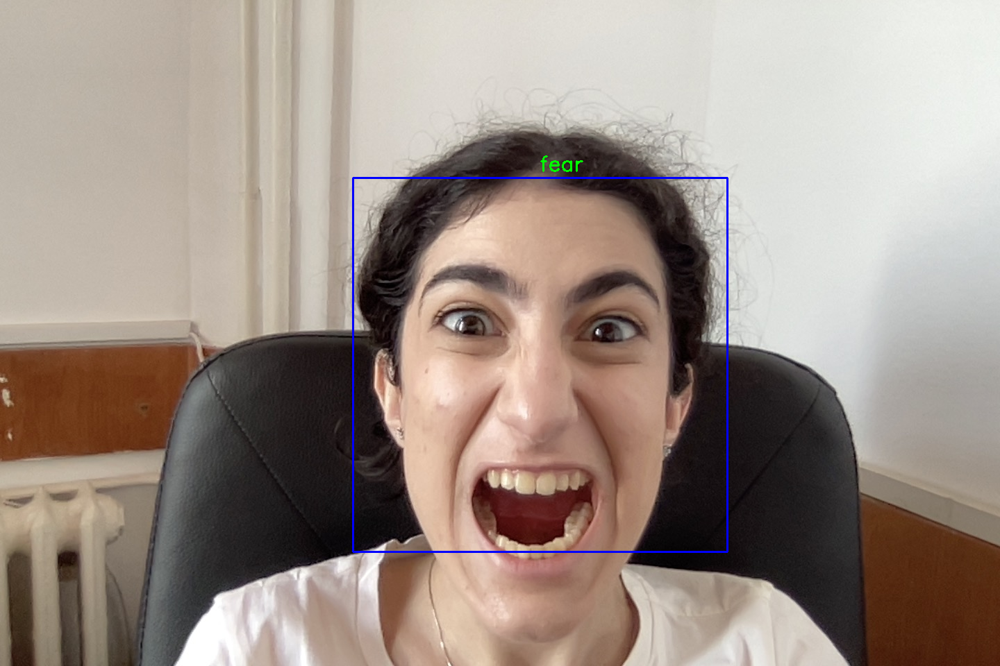

In [37]:
from keras.models import load_model
from keras.preprocessing import image
import numpy as np
import os
import cv2
import numpy as np
from os import listdir
from os.path import isfile, join
from keras.preprocessing.image import img_to_array
from google.colab.patches import cv2_imshow

# adaugare load model

classifier = load_model("/content/drive/MyDrive/GitHub/licenta/outputs/output22/checkpoint3")

face_classifier = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

def face_detector(img):
    faces = face_classifier.detectMultiScale(img, 1.3, 5)
    if faces is ():
        return (0,0,0,0), np.zeros((224,224), np.uint8), img
    allfaces = []   
    rects = []
    for (x,y,w,h) in faces:
        cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
        roi = img[y:y+h, x:x+w]
        roi = cv2.resize(roi, (224, 224), interpolation = cv2.INTER_AREA)
        allfaces.append(roi)
        rects.append((x,w,y,h))
    return rects, allfaces, img

img = cv2.imread("/content/drive/MyDrive/GitHub/licenta/poze_test_separat/poza13.jpg")
rects, faces, image = face_detector(img)

i = 0
for face in faces:
    roi = face.astype("float") / 255.0
    roi = img_to_array(roi)
    roi = np.expand_dims(roi, axis=0)


    # make a prediction on the ROI, then lookup the class
    preds = classifier.predict(roi)[0]
    label = class_labels[preds.argmax()]   

    #Overlay our detected emotion on our pic
    label_position = (rects[i][0] + int((rects[i][1]/2)), abs(rects[i][2] - 10))
    i =+ 1
    cv2.putText(image, label, label_position , cv2.FONT_HERSHEY_SIMPLEX,1, (0,255,0), 2)
    
cv2_imshow(image)
cv2.waitKey(0)

cv2.destroyAllWindows()

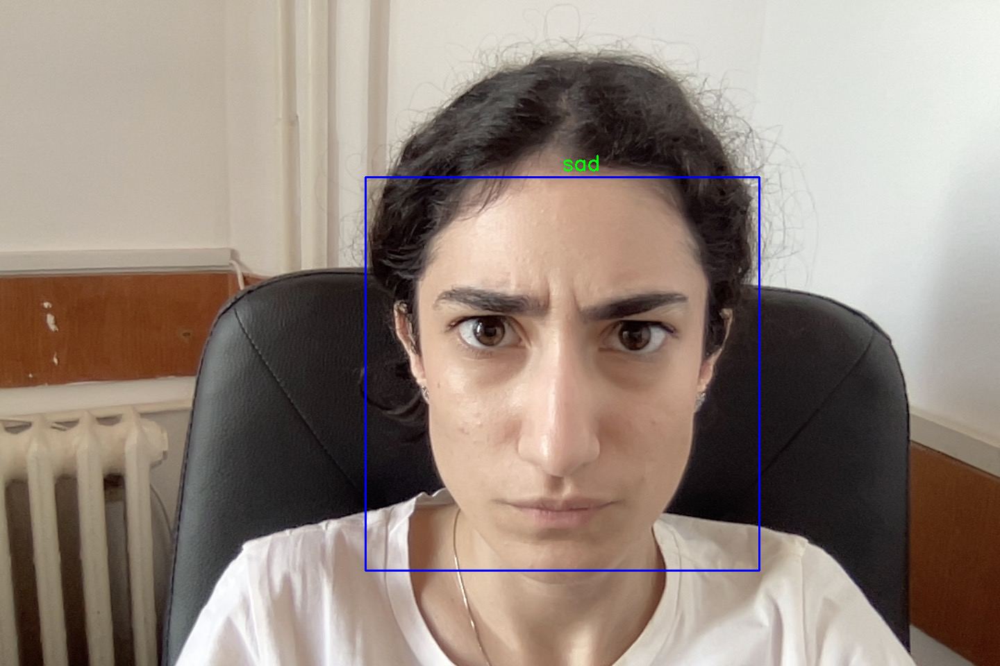

In [40]:
from keras.models import load_model
from keras.preprocessing import image
import numpy as np
import os
import cv2
import numpy as np
from os import listdir
from os.path import isfile, join
from keras.preprocessing.image import img_to_array
from google.colab.patches import cv2_imshow

# adaugare load model

classifier = load_model("/content/drive/MyDrive/GitHub/licenta/outputs/output22/checkpoint3")

face_classifier = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

def face_detector(img):
    faces = face_classifier.detectMultiScale(img, 1.3, 5)
    if faces is ():
        return (0,0,0,0), np.zeros((224,224), np.uint8), img
    allfaces = []   
    rects = []
    for (x,y,w,h) in faces:
        cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
        roi = img[y:y+h, x:x+w]
        roi = cv2.resize(roi, (224, 224), interpolation = cv2.INTER_AREA)
        allfaces.append(roi)
        rects.append((x,w,y,h))
    return rects, allfaces, img

img = cv2.imread("/content/drive/MyDrive/GitHub/licenta/poze_test_separat/poza14.jpg")
rects, faces, image = face_detector(img)

i = 0
for face in faces:
    roi = face.astype("float") / 255.0
    roi = img_to_array(roi)
    roi = np.expand_dims(roi, axis=0)


    # make a prediction on the ROI, then lookup the class
    preds = classifier.predict(roi)[0]
    label = class_labels[preds.argmax()]   

    #Overlay our detected emotion on our pic
    label_position = (rects[i][0] + int((rects[i][1]/2)), abs(rects[i][2] - 10))
    i =+ 1
    cv2.putText(image, label, label_position , cv2.FONT_HERSHEY_SIMPLEX,1, (0,255,0), 2)
    
cv2_imshow(image)
cv2.waitKey(0)

cv2.destroyAllWindows()

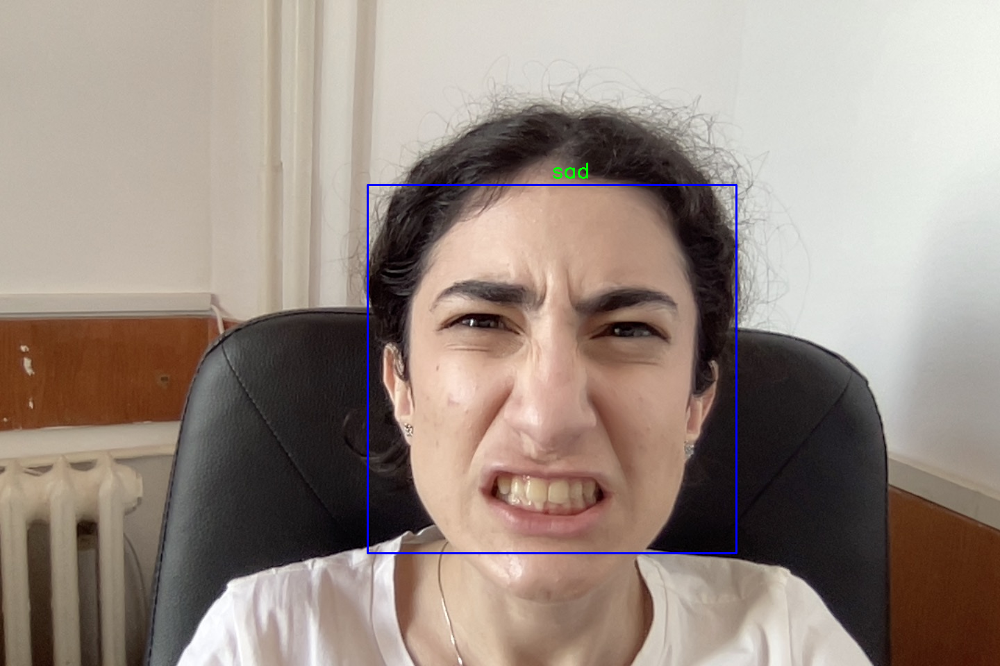

In [43]:
from keras.models import load_model
from keras.preprocessing import image
import numpy as np
import os
import cv2
import numpy as np
from os import listdir
from os.path import isfile, join
from keras.preprocessing.image import img_to_array
from google.colab.patches import cv2_imshow

# adaugare load model

classifier = load_model("/content/drive/MyDrive/GitHub/licenta/outputs/output22/checkpoint3")

face_classifier = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

def face_detector(img):
    faces = face_classifier.detectMultiScale(img, 1.3, 5)
    if faces is ():
        return (0,0,0,0), np.zeros((224,224), np.uint8), img
    allfaces = []   
    rects = []
    for (x,y,w,h) in faces:
        cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
        roi = img[y:y+h, x:x+w]
        roi = cv2.resize(roi, (224, 224), interpolation = cv2.INTER_AREA)
        allfaces.append(roi)
        rects.append((x,w,y,h))
    return rects, allfaces, img

img = cv2.imread("/content/drive/MyDrive/GitHub/licenta/poze_test_separat/poza15.jpg")
rects, faces, image = face_detector(img)

i = 0
for face in faces:
    roi = face.astype("float") / 255.0
    roi = img_to_array(roi)
    roi = np.expand_dims(roi, axis=0)


    # make a prediction on the ROI, then lookup the class
    preds = classifier.predict(roi)[0]
    label = class_labels[preds.argmax()]   

    #Overlay our detected emotion on our pic
    label_position = (rects[i][0] + int((rects[i][1]/2)), abs(rects[i][2] - 10))
    i =+ 1
    cv2.putText(image, label, label_position , cv2.FONT_HERSHEY_SIMPLEX,1, (0,255,0), 2)
    
cv2_imshow(image)
cv2.waitKey(0)

cv2.destroyAllWindows()

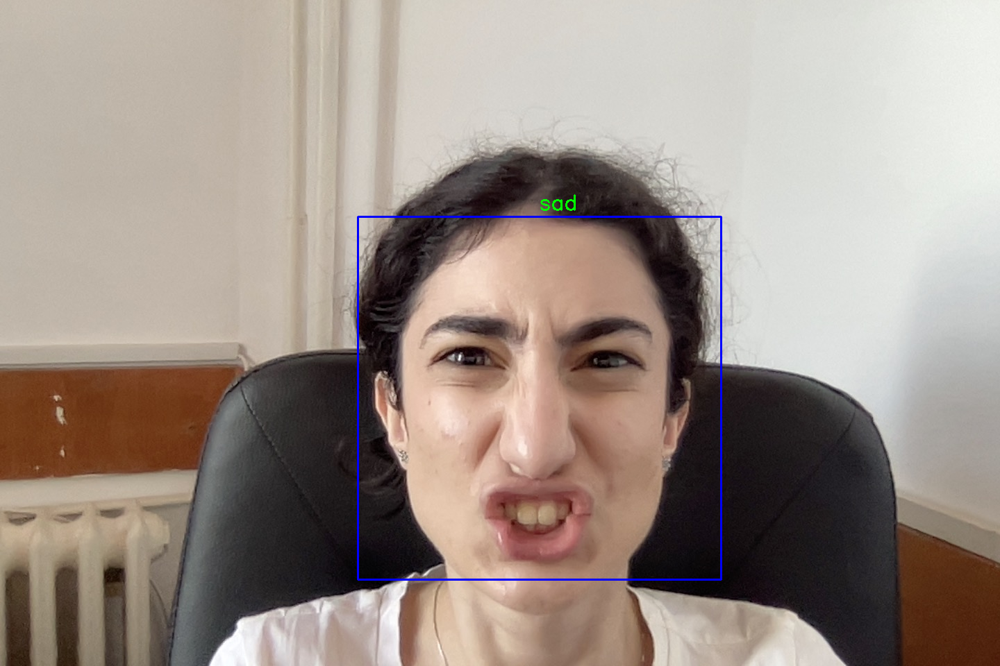

In [44]:
from keras.models import load_model
from keras.preprocessing import image
import numpy as np
import os
import cv2
import numpy as np
from os import listdir
from os.path import isfile, join
from keras.preprocessing.image import img_to_array
from google.colab.patches import cv2_imshow

# adaugare load model

classifier = load_model("/content/drive/MyDrive/GitHub/licenta/outputs/output22/checkpoint3")

face_classifier = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

def face_detector(img):
    faces = face_classifier.detectMultiScale(img, 1.3, 5)
    if faces is ():
        return (0,0,0,0), np.zeros((224,224), np.uint8), img
    allfaces = []   
    rects = []
    for (x,y,w,h) in faces:
        cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
        roi = img[y:y+h, x:x+w]
        roi = cv2.resize(roi, (224, 224), interpolation = cv2.INTER_AREA)
        allfaces.append(roi)
        rects.append((x,w,y,h))
    return rects, allfaces, img

img = cv2.imread("/content/drive/MyDrive/GitHub/licenta/poze_test_separat/poza16.jpg")
rects, faces, image = face_detector(img)

i = 0
for face in faces:
    roi = face.astype("float") / 255.0
    roi = img_to_array(roi)
    roi = np.expand_dims(roi, axis=0)


    # make a prediction on the ROI, then lookup the class
    preds = classifier.predict(roi)[0]
    label = class_labels[preds.argmax()]   

    #Overlay our detected emotion on our pic
    label_position = (rects[i][0] + int((rects[i][1]/2)), abs(rects[i][2] - 10))
    i =+ 1
    cv2.putText(image, label, label_position , cv2.FONT_HERSHEY_SIMPLEX,1, (0,255,0), 2)
    
cv2_imshow(image)
cv2.waitKey(0)

cv2.destroyAllWindows()

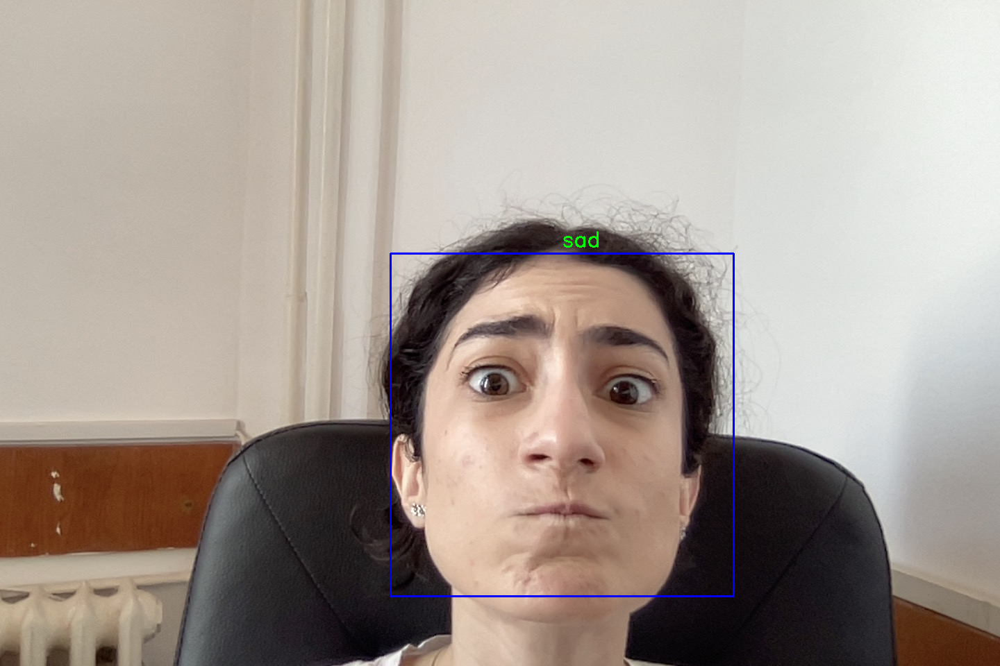

In [45]:
from keras.models import load_model
from keras.preprocessing import image
import numpy as np
import os
import cv2
import numpy as np
from os import listdir
from os.path import isfile, join
from keras.preprocessing.image import img_to_array
from google.colab.patches import cv2_imshow

# adaugare load model

classifier = load_model("/content/drive/MyDrive/GitHub/licenta/outputs/output22/checkpoint3")

face_classifier = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

def face_detector(img):
    faces = face_classifier.detectMultiScale(img, 1.3, 5)
    if faces is ():
        return (0,0,0,0), np.zeros((224,224), np.uint8), img
    allfaces = []   
    rects = []
    for (x,y,w,h) in faces:
        cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
        roi = img[y:y+h, x:x+w]
        roi = cv2.resize(roi, (224, 224), interpolation = cv2.INTER_AREA)
        allfaces.append(roi)
        rects.append((x,w,y,h))
    return rects, allfaces, img

img = cv2.imread("/content/drive/MyDrive/GitHub/licenta/poze_test_separat/poza17.jpg")
rects, faces, image = face_detector(img)

i = 0
for face in faces:
    roi = face.astype("float") / 255.0
    roi = img_to_array(roi)
    roi = np.expand_dims(roi, axis=0)


    # make a prediction on the ROI, then lookup the class
    preds = classifier.predict(roi)[0]
    label = class_labels[preds.argmax()]   

    #Overlay our detected emotion on our pic
    label_position = (rects[i][0] + int((rects[i][1]/2)), abs(rects[i][2] - 10))
    i =+ 1
    cv2.putText(image, label, label_position , cv2.FONT_HERSHEY_SIMPLEX,1, (0,255,0), 2)
    
cv2_imshow(image)
cv2.waitKey(0)

cv2.destroyAllWindows()

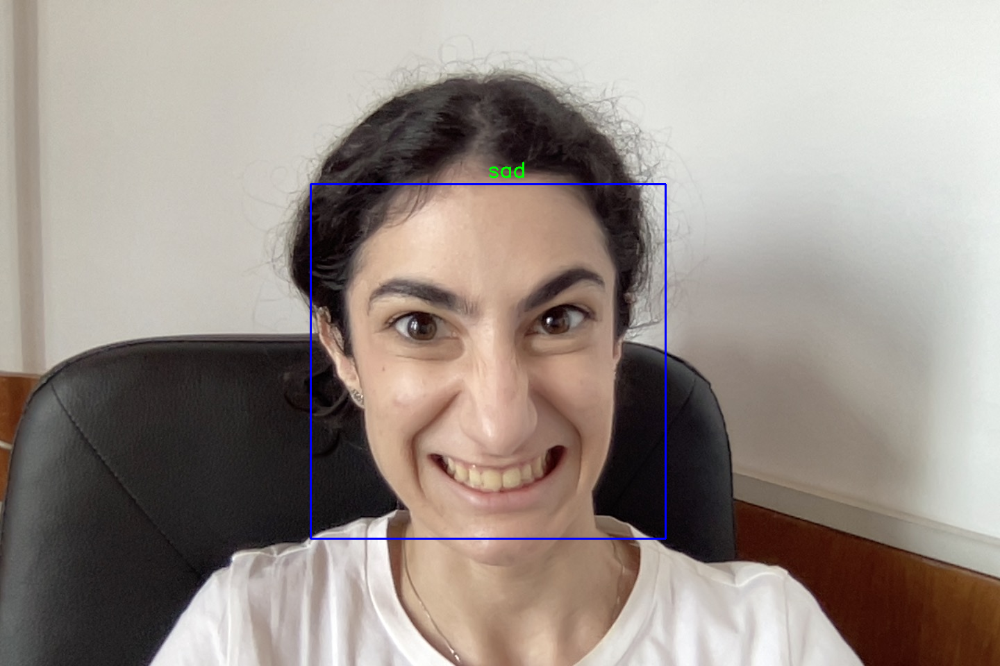

In [46]:
from keras.models import load_model
from keras.preprocessing import image
import numpy as np
import os
import cv2
import numpy as np
from os import listdir
from os.path import isfile, join
from keras.preprocessing.image import img_to_array
from google.colab.patches import cv2_imshow

# adaugare load model

classifier = load_model("/content/drive/MyDrive/GitHub/licenta/outputs/output22/checkpoint3")

face_classifier = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

def face_detector(img):
    faces = face_classifier.detectMultiScale(img, 1.3, 5)
    if faces is ():
        return (0,0,0,0), np.zeros((224,224), np.uint8), img
    allfaces = []   
    rects = []
    for (x,y,w,h) in faces:
        cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
        roi = img[y:y+h, x:x+w]
        roi = cv2.resize(roi, (224, 224), interpolation = cv2.INTER_AREA)
        allfaces.append(roi)
        rects.append((x,w,y,h))
    return rects, allfaces, img

img = cv2.imread("/content/drive/MyDrive/GitHub/licenta/poze_test_separat/poza18.jpg")
rects, faces, image = face_detector(img)

i = 0
for face in faces:
    roi = face.astype("float") / 255.0
    roi = img_to_array(roi)
    roi = np.expand_dims(roi, axis=0)


    # make a prediction on the ROI, then lookup the class
    preds = classifier.predict(roi)[0]
    label = class_labels[preds.argmax()]   

    #Overlay our detected emotion on our pic
    label_position = (rects[i][0] + int((rects[i][1]/2)), abs(rects[i][2] - 10))
    i =+ 1
    cv2.putText(image, label, label_position , cv2.FONT_HERSHEY_SIMPLEX,1, (0,255,0), 2)
    
cv2_imshow(image)
cv2.waitKey(0)

cv2.destroyAllWindows()

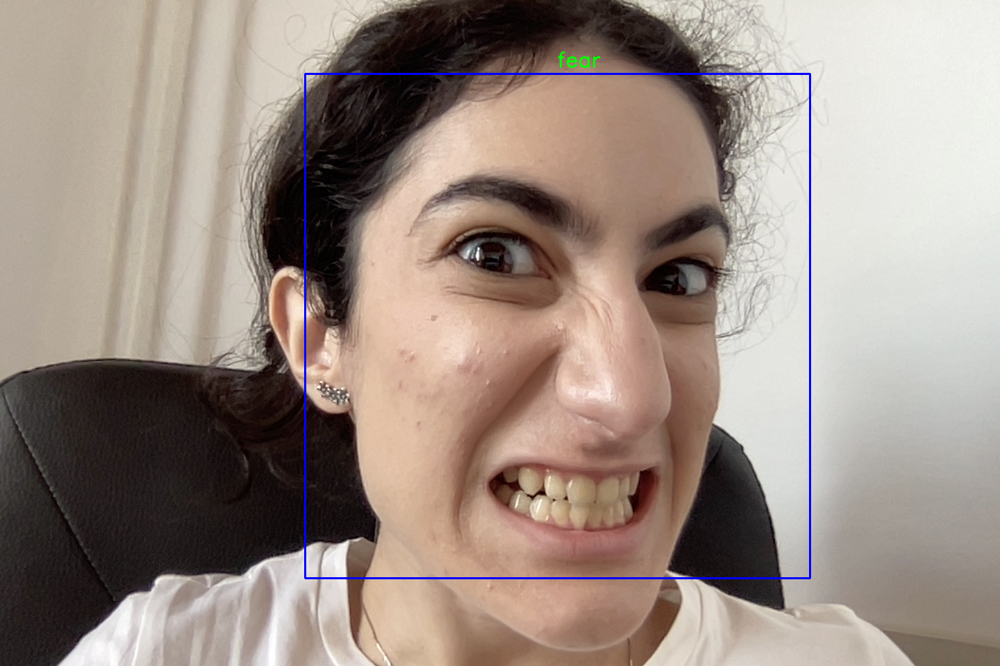

In [48]:
from keras.models import load_model
from keras.preprocessing import image
import numpy as np
import os
import cv2
import numpy as np
from os import listdir
from os.path import isfile, join
from keras.preprocessing.image import img_to_array
from google.colab.patches import cv2_imshow

# adaugare load model

classifier = load_model("/content/drive/MyDrive/GitHub/licenta/outputs/output22/checkpoint3")

face_classifier = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

def face_detector(img):
    faces = face_classifier.detectMultiScale(img, 1.3, 5)
    if faces is ():
        return (0,0,0,0), np.zeros((224,224), np.uint8), img
    allfaces = []   
    rects = []
    for (x,y,w,h) in faces:
        cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
        roi = img[y:y+h, x:x+w]
        roi = cv2.resize(roi, (224, 224), interpolation = cv2.INTER_AREA)
        allfaces.append(roi)
        rects.append((x,w,y,h))
    return rects, allfaces, img

img = cv2.imread("/content/drive/MyDrive/GitHub/licenta/poze_test_separat/poza19.jpg")
rects, faces, image = face_detector(img)

i = 0
for face in faces:
    roi = face.astype("float") / 255.0
    roi = img_to_array(roi)
    roi = np.expand_dims(roi, axis=0)


    # make a prediction on the ROI, then lookup the class
    preds = classifier.predict(roi)[0]
    label = class_labels[preds.argmax()]   

    #Overlay our detected emotion on our pic
    label_position = (rects[i][0] + int((rects[i][1]/2)), abs(rects[i][2] - 10))
    i =+ 1
    cv2.putText(image, label, label_position , cv2.FONT_HERSHEY_SIMPLEX,1, (0,255,0), 2)
    
cv2_imshow(image)
cv2.waitKey(0)

cv2.destroyAllWindows()

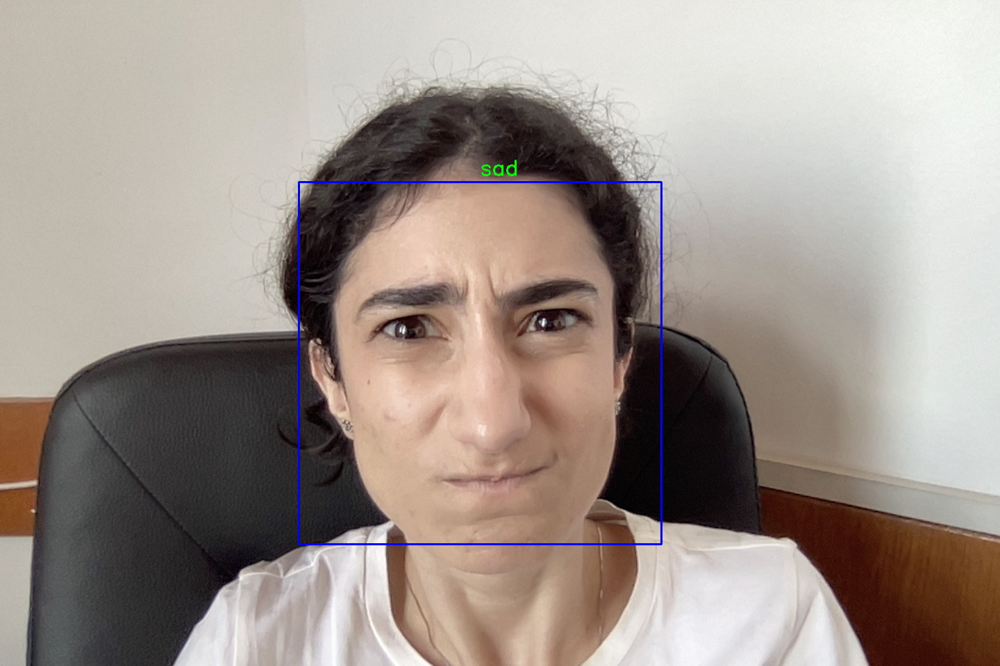

In [50]:
from keras.models import load_model
from keras.preprocessing import image
import numpy as np
import os
import cv2
import numpy as np
from os import listdir
from os.path import isfile, join
from keras.preprocessing.image import img_to_array
from google.colab.patches import cv2_imshow

# adaugare load model

classifier = load_model("/content/drive/MyDrive/GitHub/licenta/outputs/output22/checkpoint3")

face_classifier = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

def face_detector(img):
    faces = face_classifier.detectMultiScale(img, 1.3, 5)
    if faces is ():
        return (0,0,0,0), np.zeros((224,224), np.uint8), img
    allfaces = []   
    rects = []
    for (x,y,w,h) in faces:
        cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
        roi = img[y:y+h, x:x+w]
        roi = cv2.resize(roi, (224, 224), interpolation = cv2.INTER_AREA)
        allfaces.append(roi)
        rects.append((x,w,y,h))
    return rects, allfaces, img

img = cv2.imread("/content/drive/MyDrive/GitHub/licenta/poze_test_separat/poza20.jpg")
rects, faces, image = face_detector(img)

i = 0
for face in faces:
    roi = face.astype("float") / 255.0
    roi = img_to_array(roi)
    roi = np.expand_dims(roi, axis=0)


    # make a prediction on the ROI, then lookup the class
    preds = classifier.predict(roi)[0]
    label = class_labels[preds.argmax()]   

    #Overlay our detected emotion on our pic
    label_position = (rects[i][0] + int((rects[i][1]/2)), abs(rects[i][2] - 10))
    i =+ 1
    cv2.putText(image, label, label_position , cv2.FONT_HERSHEY_SIMPLEX,1, (0,255,0), 2)
    
cv2_imshow(image)
cv2.waitKey(0)

cv2.destroyAllWindows()

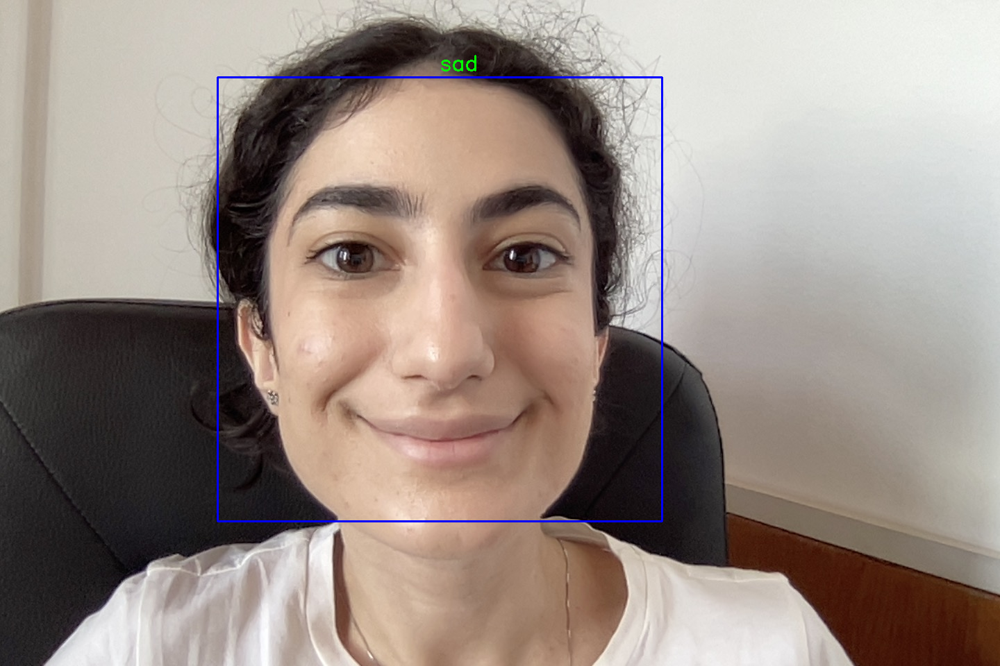

In [56]:
from keras.models import load_model
from keras.preprocessing import image
import numpy as np
import os
import cv2
import numpy as np
from os import listdir
from os.path import isfile, join
from keras.preprocessing.image import img_to_array
from google.colab.patches import cv2_imshow

# adaugare load model

classifier = load_model("/content/drive/MyDrive/GitHub/licenta/outputs/output22/checkpoint3")

face_classifier = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

def face_detector(img):
    faces = face_classifier.detectMultiScale(img, 1.3, 5)
    if faces is ():
        return (0,0,0,0), np.zeros((224,224), np.uint8), img
    allfaces = []   
    rects = []
    for (x,y,w,h) in faces:
        cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
        roi = img[y:y+h, x:x+w]
        roi = cv2.resize(roi, (224, 224), interpolation = cv2.INTER_AREA)
        allfaces.append(roi)
        rects.append((x,w,y,h))
    return rects, allfaces, img

img = cv2.imread("/content/drive/MyDrive/GitHub/licenta/poze_test_separat/poza21.jpg")
rects, faces, image = face_detector(img)

i = 0
for face in faces:
    roi = face.astype("float") / 255.0
    roi = img_to_array(roi)
    roi = np.expand_dims(roi, axis=0)


    # make a prediction on the ROI, then lookup the class
    preds = classifier.predict(roi)[0]
    label = class_labels[preds.argmax()]   

    #Overlay our detected emotion on our pic
    label_position = (rects[i][0] + int((rects[i][1]/2)), abs(rects[i][2] - 10))
    i =+ 1
    cv2.putText(image, label, label_position , cv2.FONT_HERSHEY_SIMPLEX,1, (0,255,0), 2)
    
cv2_imshow(image)
cv2.waitKey(0)

cv2.destroyAllWindows()

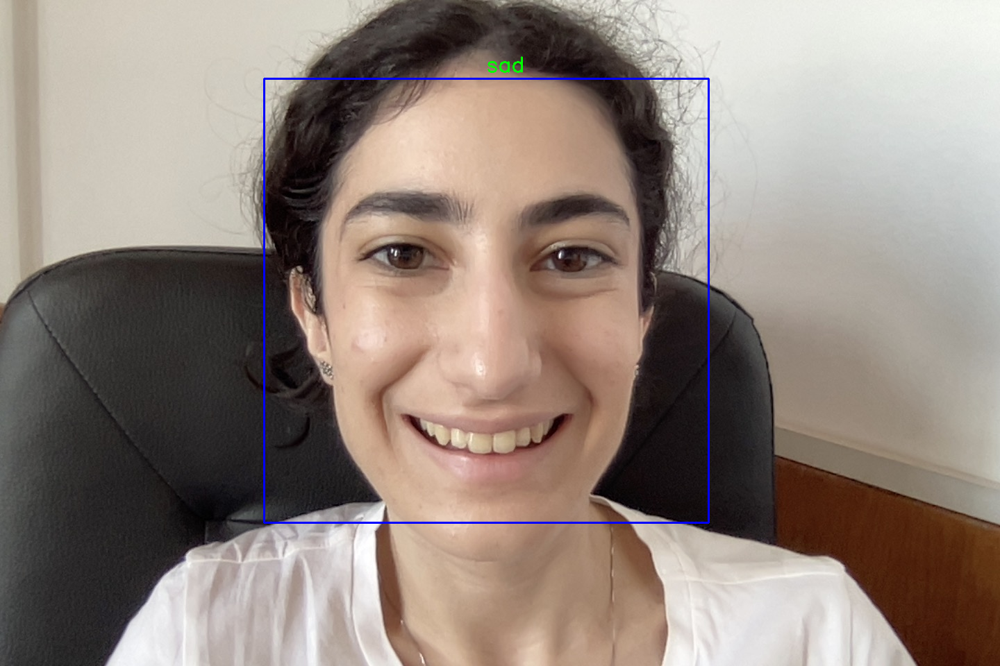

In [57]:
from keras.models import load_model
from keras.preprocessing import image
import numpy as np
import os
import cv2
import numpy as np
from os import listdir
from os.path import isfile, join
from keras.preprocessing.image import img_to_array
from google.colab.patches import cv2_imshow

# adaugare load model

classifier = load_model("/content/drive/MyDrive/GitHub/licenta/outputs/output22/checkpoint3")

face_classifier = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

def face_detector(img):
    faces = face_classifier.detectMultiScale(img, 1.3, 5)
    if faces is ():
        return (0,0,0,0), np.zeros((224,224), np.uint8), img
    allfaces = []   
    rects = []
    for (x,y,w,h) in faces:
        cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
        roi = img[y:y+h, x:x+w]
        roi = cv2.resize(roi, (224, 224), interpolation = cv2.INTER_AREA)
        allfaces.append(roi)
        rects.append((x,w,y,h))
    return rects, allfaces, img

img = cv2.imread("/content/drive/MyDrive/GitHub/licenta/poze_test_separat/poza22.jpg")
rects, faces, image = face_detector(img)

i = 0
for face in faces:
    roi = face.astype("float") / 255.0
    roi = img_to_array(roi)
    roi = np.expand_dims(roi, axis=0)


    # make a prediction on the ROI, then lookup the class
    preds = classifier.predict(roi)[0]
    label = class_labels[preds.argmax()]   

    #Overlay our detected emotion on our pic
    label_position = (rects[i][0] + int((rects[i][1]/2)), abs(rects[i][2] - 10))
    i =+ 1
    cv2.putText(image, label, label_position , cv2.FONT_HERSHEY_SIMPLEX,1, (0,255,0), 2)
    
cv2_imshow(image)
cv2.waitKey(0)

cv2.destroyAllWindows()

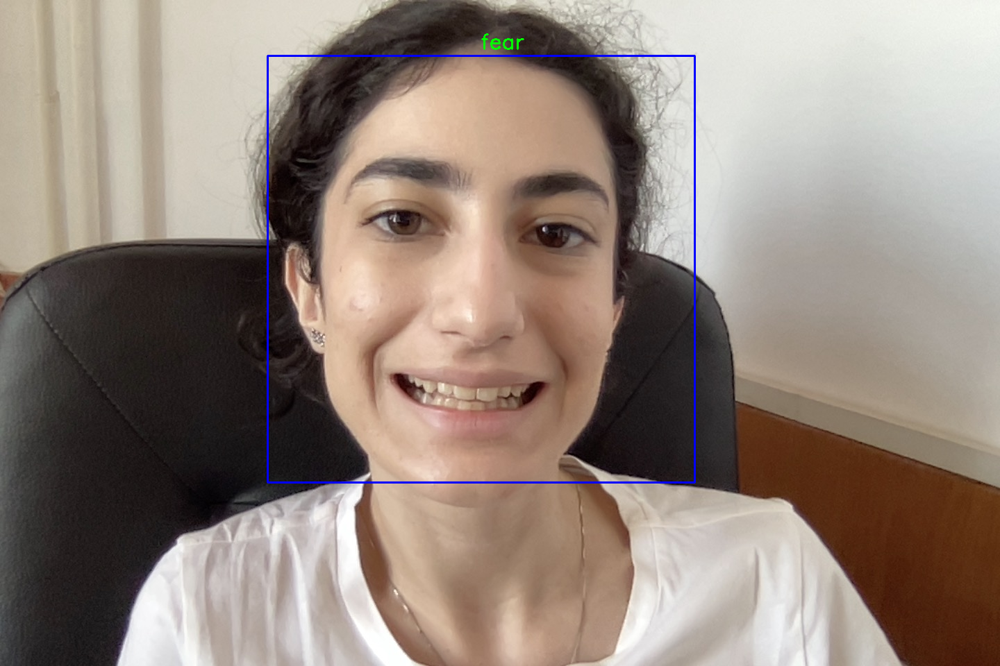

In [58]:
from keras.models import load_model
from keras.preprocessing import image
import numpy as np
import os
import cv2
import numpy as np
from os import listdir
from os.path import isfile, join
from keras.preprocessing.image import img_to_array
from google.colab.patches import cv2_imshow

# adaugare load model

classifier = load_model("/content/drive/MyDrive/GitHub/licenta/outputs/output22/checkpoint3")

face_classifier = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

def face_detector(img):
    faces = face_classifier.detectMultiScale(img, 1.3, 5)
    if faces is ():
        return (0,0,0,0), np.zeros((224,224), np.uint8), img
    allfaces = []   
    rects = []
    for (x,y,w,h) in faces:
        cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
        roi = img[y:y+h, x:x+w]
        roi = cv2.resize(roi, (224, 224), interpolation = cv2.INTER_AREA)
        allfaces.append(roi)
        rects.append((x,w,y,h))
    return rects, allfaces, img

img = cv2.imread("/content/drive/MyDrive/GitHub/licenta/poze_test_separat/poza23.jpg")
rects, faces, image = face_detector(img)

i = 0
for face in faces:
    roi = face.astype("float") / 255.0
    roi = img_to_array(roi)
    roi = np.expand_dims(roi, axis=0)


    # make a prediction on the ROI, then lookup the class
    preds = classifier.predict(roi)[0]
    label = class_labels[preds.argmax()]   

    #Overlay our detected emotion on our pic
    label_position = (rects[i][0] + int((rects[i][1]/2)), abs(rects[i][2] - 10))
    i =+ 1
    cv2.putText(image, label, label_position , cv2.FONT_HERSHEY_SIMPLEX,1, (0,255,0), 2)
    
cv2_imshow(image)
cv2.waitKey(0)

cv2.destroyAllWindows()

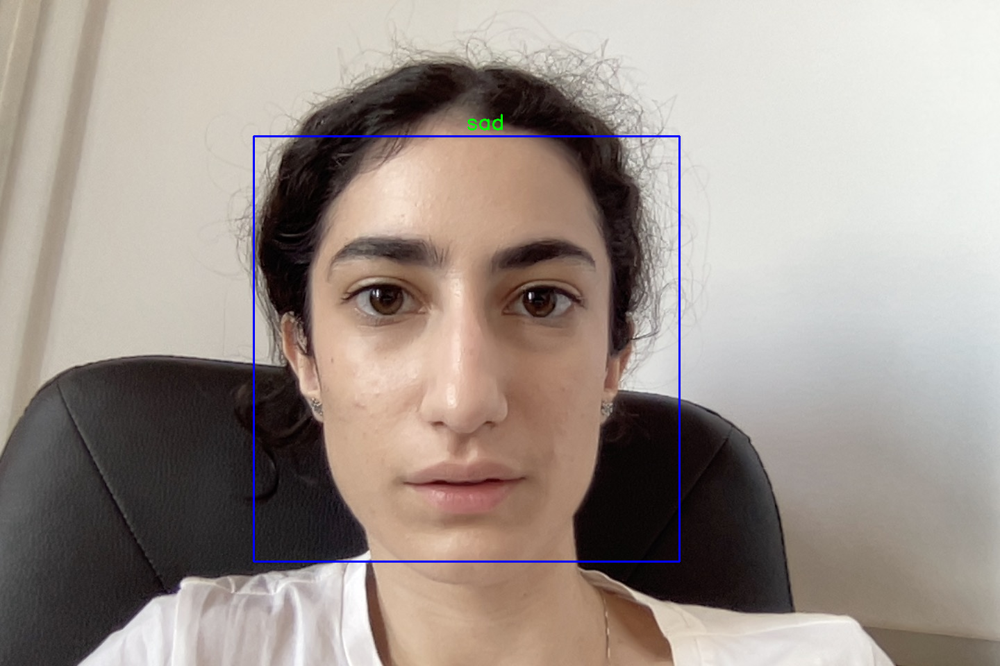

In [59]:
from keras.models import load_model
from keras.preprocessing import image
import numpy as np
import os
import cv2
import numpy as np
from os import listdir
from os.path import isfile, join
from keras.preprocessing.image import img_to_array
from google.colab.patches import cv2_imshow

# adaugare load model

classifier = load_model("/content/drive/MyDrive/GitHub/licenta/outputs/output22/checkpoint3")

face_classifier = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

def face_detector(img):
    faces = face_classifier.detectMultiScale(img, 1.3, 5)
    if faces is ():
        return (0,0,0,0), np.zeros((224,224), np.uint8), img
    allfaces = []   
    rects = []
    for (x,y,w,h) in faces:
        cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
        roi = img[y:y+h, x:x+w]
        roi = cv2.resize(roi, (224, 224), interpolation = cv2.INTER_AREA)
        allfaces.append(roi)
        rects.append((x,w,y,h))
    return rects, allfaces, img

img = cv2.imread("/content/drive/MyDrive/GitHub/licenta/poze_test_separat/poza24.jpg")
rects, faces, image = face_detector(img)

i = 0
for face in faces:
    roi = face.astype("float") / 255.0
    roi = img_to_array(roi)
    roi = np.expand_dims(roi, axis=0)


    # make a prediction on the ROI, then lookup the class
    preds = classifier.predict(roi)[0]
    label = class_labels[preds.argmax()]   

    #Overlay our detected emotion on our pic
    label_position = (rects[i][0] + int((rects[i][1]/2)), abs(rects[i][2] - 10))
    i =+ 1
    cv2.putText(image, label, label_position , cv2.FONT_HERSHEY_SIMPLEX,1, (0,255,0), 2)
    
cv2_imshow(image)
cv2.waitKey(0)

cv2.destroyAllWindows()

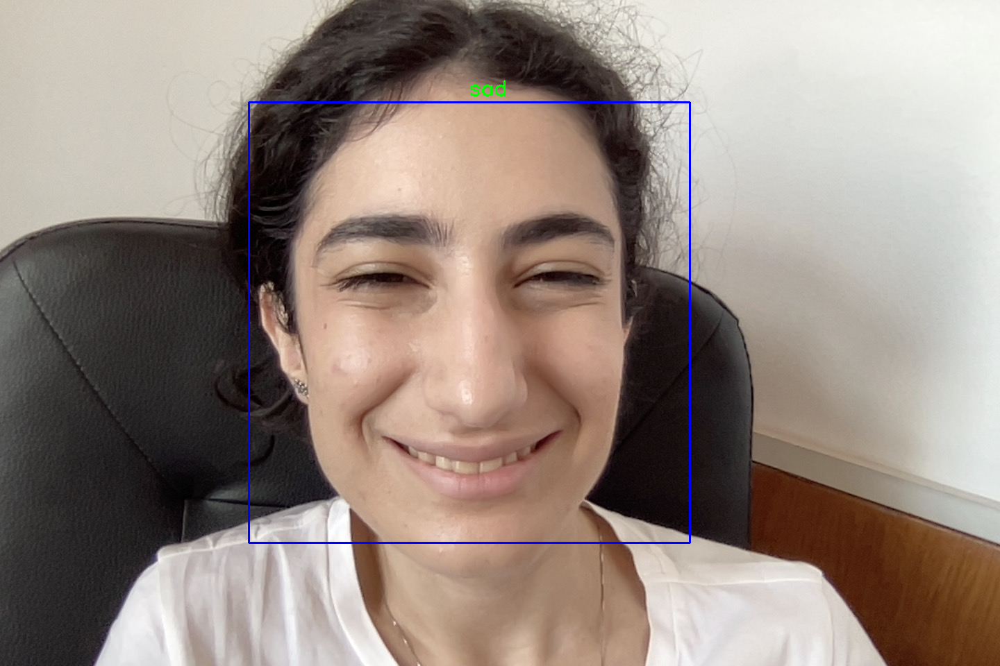

In [62]:
from keras.models import load_model
from keras.preprocessing import image
import numpy as np
import os
import cv2
import numpy as np
from os import listdir
from os.path import isfile, join
from keras.preprocessing.image import img_to_array
from google.colab.patches import cv2_imshow

# adaugare load model

classifier = load_model("/content/drive/MyDrive/GitHub/licenta/outputs/output22/checkpoint3")

face_classifier = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

def face_detector(img):
    faces = face_classifier.detectMultiScale(img, 1.3, 5)
    if faces is ():
        return (0,0,0,0), np.zeros((224,224), np.uint8), img
    allfaces = []   
    rects = []
    for (x,y,w,h) in faces:
        cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
        roi = img[y:y+h, x:x+w]
        roi = cv2.resize(roi, (224, 224), interpolation = cv2.INTER_AREA)
        allfaces.append(roi)
        rects.append((x,w,y,h))
    return rects, allfaces, img

img = cv2.imread("/content/drive/MyDrive/GitHub/licenta/poze_test_separat/poza25.jpg")
rects, faces, image = face_detector(img)

i = 0
for face in faces:
    roi = face.astype("float") / 255.0
    roi = img_to_array(roi)
    roi = np.expand_dims(roi, axis=0)


    # make a prediction on the ROI, then lookup the class
    preds = classifier.predict(roi)[0]
    label = class_labels[preds.argmax()]   

    #Overlay our detected emotion on our pic
    label_position = (rects[i][0] + int((rects[i][1]/2)), abs(rects[i][2] - 10))
    i =+ 1
    cv2.putText(image, label, label_position , cv2.FONT_HERSHEY_SIMPLEX,1, (0,255,0), 2)
    
cv2_imshow(image)
cv2.waitKey(0)

cv2.destroyAllWindows()